In [1]:
import cv2
import pandas as pd
from IPython.display import display
import os
import math
import random
import shutil
import imgaug.augmenters as aug
from IPython.display import display, Markdown, Latex

In [2]:
# Mounting google Drive
try:
    from google.colab import drive
    drive.mount('/content/drive')
    folder_path = 'drive/MyDrive/TesisMV/'
except:
    folder_path = '../'

In [3]:
df_labels = pd.read_json(folder_path + "labels/normalized_df.json", orient='index', encoding='latin-1')
display(df_labels)
df_classes = pd.read_csv(folder_path + "labels/class_labels.csv", index_col=0)
display(df_classes)
df_labels_class = df_labels.join(df_classes, how='inner')
display(df_labels_class)

,pendent,teardrop,horizontal,panel,group,vertical,bar,floating,enclosing,shorter,...,light,body,bird,striped,worm,angular,raised,head,bird-seed,long
1a,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1b,1,1,1,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1c,0,0,1,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1d,0,0,0,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1e,0,0,1,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96e,0,0,1,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,1,0
96f,0,0,0,1,0,1,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
96g,0,0,0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,0,0,0,0
96h,0,0,1,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1


,chapter,subchapter
1a,strokes and lines,strokes
1b,strokes and lines,strokes
1c,strokes and lines,strokes
1d,strokes and lines,strokes
1e,strokes and lines,strokes
...,...,...
96e,pictographics,trees and animals
96f,pictographics,trees and animals
96g,pictographics,trees and animals
96h,pictographics,trees and animals


,pendent,teardrop,horizontal,panel,group,vertical,bar,floating,enclosing,shorter,...,bird,striped,worm,angular,raised,head,bird-seed,long,chapter,subchapter
1a,1,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,strokes and lines,strokes
1b,1,1,1,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,strokes and lines,strokes
1c,0,0,1,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,strokes and lines,strokes
1d,0,0,0,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,strokes and lines,strokes
1e,0,0,1,1,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,strokes and lines,strokes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96e,0,0,1,1,0,0,0,0,0,0,...,1,0,0,0,0,0,1,0,pictographics,trees and animals
96f,0,0,0,1,0,1,0,0,0,0,...,1,0,0,0,0,0,0,0,pictographics,trees and animals
96g,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,pictographics,trees and animals
96h,0,0,1,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,pictographics,trees and animals


In [4]:
df_grouped = df_labels_class.drop(columns='subchapter').groupby(['chapter']).sum()
display(df_grouped)

,pendent,teardrop,horizontal,panel,group,vertical,bar,floating,enclosing,shorter,...,light,body,bird,striped,worm,angular,raised,head,bird-seed,long
chapter,,,,,,,,,,,,,,,,,,,,,
circular ornaments,6,0,64,71,0,11,3,1,76,0,...,0,0,0,0,0,0,0,0,0,0
lozenge,0,0,31,53,0,26,3,2,8,0,...,0,0,0,0,0,0,0,0,0,0
pictographics,0,0,17,25,0,10,1,0,0,0,...,1,18,22,1,1,1,2,1,1,2
rectangular ornaments,3,0,79,93,1,17,3,0,2,0,...,0,0,0,0,0,0,0,0,0,0
strokes and lines,3,2,56,63,4,38,35,1,1,1,...,0,0,0,0,0,0,0,0,0,0
triangular ornaments,9,0,84,103,5,38,7,7,8,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
labels_group = {}

for group in df_grouped.index:
    labels_group[group] = []
    match = df_grouped.loc[group].loc[df_grouped.loc[group].gt(0)]
    labels_group[group] = match.index.values.tolist()

labels_group_unique = {}
for group in labels_group.keys():
    labels_cp = labels_group[group].copy()
    for groupB, labelsB in labels_group.items():
        if group!=groupB:
            for labelB in labelsB:
                if labelB in labels_cp:
                    labels_cp.remove(labelB)
    labels_group_unique[group] = labels_cp

labels_qty = {}
for group, labels in labels_group_unique.items():
    labels_qty[group] = len(labels)
    display(Markdown('### {} unique labels: {}'.format(group, len(labels))))
    display(labels)

labels_qty = pd.DataFrame.from_dict(labels_qty, orient='index')

### circular ornaments unique labels: 54

['rectangular',
 'rosette',
 'flower',
 'spiked',
 'eight-armed',
 'floor',
 'stalked',
 'sixteen-pointed',
 'point',
 'lightning-wheel',
 'semicircle',
 'three-quarter',
 'disposition',
 'quarter-circle',
 'sound-waves',
 'scale',
 'losenges',
 'eleven-pointed',
 'forming',
 'lined',
 'branch',
 'dif.',
 'triple-line',
 'maltese',
 'three-winged',
 'fan',
 'midrib',
 'connecting',
 'arc',
 'near',
 'rim',
 'v-shaped',
 'four-leaved',
 'twelve-leaved',
 'seven-leaved',
 'four-spoked',
 'wheel',
 'circular',
 'sunburst',
 'flanking',
 'tangent',
 'tagential',
 'tangets',
 'elongated',
 'crossed',
 'concentrique',
 'cable',
 'doted',
 'spiral',
 'inner',
 'looped',
 'running',
 'half-circles',
 'pothook']

### lozenge unique labels: 18

['two-tiered',
 'outwards',
 'slack',
 'outside',
 'three-tiered',
 'four-tiered',
 'triple-outline',
 'quatered',
 'side',
 'cross-hathed',
 'linked',
 'check',
 'tapestry',
 'net.',
 'like',
 'underlying',
 'schematized',
 'lozenge-cross']

### pictographics unique labels: 17

['tongue',
 'plant',
 'figure',
 'volute',
 'palm-tree',
 'fish',
 'serpent',
 'light',
 'body',
 'bird',
 'striped',
 'worm',
 'angular',
 'raised',
 'head',
 'bird-seed',
 'long']

### rectangular ornaments unique labels: 54

['rectangle',
 'innermost',
 'set',
 'coffer',
 'cross-bar',
 'saltire',
 'doubled',
 't-shaped',
 'stalk',
 'strong',
 'half-moon',
 'double-halfmoon',
 'octofail',
 'battlement',
 'zigzag-filled',
 'interspaces',
 'link',
 'high',
 'slim',
 'attached',
 'frgt.',
 'gear-pattern',
 'formed',
 'turning',
 'meander',
 'reversed',
 'intertwined',
 'quadruple',
 'step',
 'additional',
 'downward',
 'turn',
 'wind',
 'connected',
 't-meander',
 'beam',
 'remaining',
 'meander-like',
 'z-shaped',
 'continuous',
 'repetition',
 'alternatively',
 'meander-type',
 'trident',
 'sape',
 'two-sided',
 "'comb'",
 'type',
 'mã©andre',
 'hachurã©',
 'panneau',
 'acute-angled',
 'hooked',
 'arm']

### strokes and lines unique labels: 19

['teardrop',
 'shorter',
 'framed',
 'pannel',
 'inserted',
 'crossing',
 'comb-like',
 'free',
 'design',
 'diagonally',
 'half-lines',
 'interlocked',
 'latticing',
 'separated',
 'obliquely',
 'steep',
 'wave',
 'moon',
 'lightning']

### triangular ornaments unique labels: 50

['upwards',
 'arrow',
 'shape',
 'intersecting',
 'version',
 'previous',
 'form',
 'border',
 'form-square',
 'schoulder',
 'intertwinded',
 'linear',
 'rhodian',
 'root',
 'stock',
 'dogtooth',
 'downwards',
 'accompanied',
 'antithetic',
 'ray',
 'direction',
 'hour-glasses',
 'ax',
 'axe',
 'superimposed',
 'dissimilar',
 'white',
 'dark',
 'massive',
 'spacious',
 'obtuse',
 'metope-triglyph-frieze',
 'e',
 'cut',
 'ear',
 'corn',
 'v-chevrons',
 'facing',
 'three-limbed',
 'sigma',
 'turned',
 'four-limbed',
 'm-chevrons',
 'limbed',
 'scribble',
 'degeneration',
 'variously',
 'unframed',
 'tadpole',
 'dash']

In [6]:
labels_qty['Clase'] = labels_qty.index
labels_qty = labels_qty.rename(columns={0: 'Etiquetas'})

In [7]:
import plotly.express as px
fig = px.histogram(labels_qty, x='Clase', y = 'Etiquetas', width=600, height=400)
fig.update_layout(title_text='Etiquetas únicas por clase')
fig.show()

---

In [8]:
import os
import pickle
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
#import torch
#import torch.nn as nn
#import torchvision
#import torchvision.transforms as transforms
from PIL import Image
#import torchvision.models as models
import math
#from torch.nn.utils.rnn import pack_padded_sequence
from sklearn.metrics import accuracy_score,hamming_loss, accuracy_score, f1_score, precision_score, recall_score

%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.metrics import multilabel_confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report

from textwrap import wrap

In [10]:
root_dir = ".."
SUBCHAPTERS = False
DS_FLAGS = ['blur', 'rain', 'ref', 'rot', 'elastic']
              # 'ref': [invertX, invertY],
              # 'rot': [rotate90, rotate180, rotate270],
              # 'crop': [crop] * CROP_TIMES,
              # 'blur': [blur],
              # 'gausblur': [gausblur]
              # 'msblur': [msblur]
              # 'mtnblur': [mtnblur]
              # 'emboss': [emboss],
              # 'randaug': [randaug],
              # 'rain': [rain],
              # 'elastic': [elastic]
CROP_TIMES = 1
RANDOM_TIMES = 1
ELASTIC_TIMES = 1
GAUSBLUR_TIMES = 1
NUM_LABELS = 281

use_pos_weights = True
pos_weights_factor = 1

# para relela: 0 es 3090, 1 y 2 son 2080
# para local: 0 es 1060ti
CUDA_ID = 0

In [14]:
# This cells builds the data_flags variable, that will be used
# to map the requested data treatment to folders
MAP_TIMES = {'crop': CROP_TIMES,
         'randaug': RANDOM_TIMES,
         'elastic': ELASTIC_TIMES,
         'gausblur': GAUSBLUR_TIMES,
}

DS_FLAGS = sorted(DS_FLAGS)
data_flags = '_'.join(DS_FLAGS) if len(DS_FLAGS) > 0 else 'base'
MULTIPLE_TRANSF = ['crop', 'randaug', 'elastic', 'gausblur']
COPY_FLAGS = DS_FLAGS.copy()

for t in MULTIPLE_TRANSF:
    if t in DS_FLAGS:
        COPY_FLAGS.remove(t)
        COPY_FLAGS.append(t + str(MAP_TIMES[t]))
        data_flags = '_'.join(COPY_FLAGS)

patterns_path = os.path.join(root_dir, 'patterns', data_flags) 
labels_path = os.path.join(root_dir, 'labels', data_flags)

if not (os.path.isdir(patterns_path) and os.path.isdir(labels_path)):
    raise FileNotFoundError("No existen directorios de datos para el conjunto de flags seleccionado. Verifique que el dataset exista en {}".format(
        (os.path.isdir(patterns_path), os.path.isdir(labels_path))))
print("Patterns set encontrado en {}".format(patterns_path))
print("Labels set encontrado en {}".format(labels_path))

exp_name = f"{NUM_LABELS}L"
weights_str = str(pos_weights_factor)
weights_str = weights_str.replace('.','_')
exp_name += f'_weighted_{weights_str}' if use_pos_weights else ''
print(f"Nombre del experimento: {exp_name}")

output_dir = os.path.join(root_dir, "outputs", "alexnet_75th", data_flags, exp_name)
    
pred_path = os.path.join(output_dir, "predictions.csv")
print(f"Las predicciones se cargarán desde: {pred_path}")

Patterns set encontrado en ..\patterns\blur_rain_ref_rot_elastic1
Labels set encontrado en ..\labels\blur_rain_ref_rot_elastic1
Nombre del experimento: 281L_weighted_1
Las predicciones se cargarán desde: ..\outputs\alexnet_75th\blur_rain_ref_rot_elastic1\281L_weighted_1\predictions.csv


In [15]:
def filter_dfs(df, top_labels_df):
  df = df[df.columns.intersection(top_labels_df.index)]
  return df

def print_confusion_matrix(confusion_matrix, axes, class_label, class_names, fontsize=14, normalize=True):
    """
    Prints confusion matrix for multilabel classification.
    """
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names,
    )
    if normalize:
        #print(df_cm)
        df_cm = df_cm.div(df_cm.sum(axis=1), axis=0)
        #print(df_cm)
    heatmap = sns.heatmap(df_cm, annot=True, fmt=".2f", cbar=False, ax=axes, cmap='Blues', annot_kws={"size": 12})
    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    axes.set_ylabel('True label')
    axes.set_xlabel('Predicted label')
    axes.set_title(class_label)

def plot_multiple_matrix(cfs_matrix, present_labels, nrows=5, ncols=5, figsize=(6,10), filename="results", normalize=True):
  """
  Plots multiple confusion matrix

  Parameters:
  cfs_matrix (2D array): an array containing the multiple confusion matrix as
                         outcome of multilabel_confusion_matrix()
  present_labels (1D array): array of strings with name of labels, in the same
                             order as they are in cfs_matrix
  nrows, ncols, figsize: number of rows, columns and size of the plot
  
  """
  fig, ax = plt.subplots(nrows, ncols, figsize=figsize)

  for axes, cfs_vals, label in zip(ax.flatten(), cfs_matrix, present_labels):
      print_confusion_matrix(cfs_vals, axes, label, ["N", "Y"], normalize=normalize)

  fig.tight_layout()
  plt.show()
  #plt.savefig(filename + ".png")

def hamming_score(y_true, y_pred, normalize=True, sample_weight=None):
    '''
    Compute the Hamming score (a.k.a. label-based accuracy) for the multi-label case
    http://stackoverflow.com/q/32239577/395857
    '''
    acc_list = []
    for i in range(y_true.shape[0]):
        set_true = set( np.where(y_true[i])[0] )
        set_pred = set( np.where(y_pred[i])[0] )
        #print('\nset_true: {0}'.format(set_true))
        #print('set_pred: {0}'.format(set_pred))
        tmp_a = None
        if len(set_true) == 0 and len(set_pred) == 0:
            tmp_a = 1
        else:
            tmp_a = len(set_true.intersection(set_pred))/\
                    float( len(set_true.union(set_pred)) )
        #print('tmp_a: {0}'.format(tmp_a))
        acc_list.append(tmp_a)
    return np.mean(acc_list)

In [17]:
#pred_path = "exploring_th_predictions.csv"
FOLD = '2'
train_labels = pd.read_json(os.path.join(labels_path, FOLD, 'augmented_train_df.json'), orient='index')
labels_test = pd.read_json(os.path.join(labels_path, FOLD, 'test_df.json'), orient='index')

print(os.path.join(labels_path, FOLD, 'augmented_train_df.json'))
      
if not os.path.isfile(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle')):
    print(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'))
    raise Exception("No se logró cargar top_labels")

else:
    print(f"Usando top_labels previamente generados para {NUM_LABELS} labels")
    with open(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'), 'rb') as f:
        top_labels = pickle.load(f)
    print(top_labels)

pred_path = os.path.join('..', 'outputs', 'alexnet_75th', 'blur_rain_ref_rot_elastic1', '281L_weighted_1', FOLD, 'predictions.csv')
print(pred_path)
predictions = pd.read_csv(pred_path, index_col=0)
predictions = predictions.to_numpy()

if predictions.shape[1] == len(top_labels):
    NUM_LABELS = predictions.shape[1]

else:
 raise Exception(f"ATENCIÓN: El archivo de predicciones tiene {predictions.shape[1]} etiquetas pero top_labels tiene {len(top_labels)}")

..\labels\blur_rain_ref_rot_elastic1\2\augmented_train_df.json
Usando top_labels previamente generados para 281 labels
panel           266
horizontal      218
ornament        111
hatched         102
vertical         92
               ... 
outside           1
three-tiered      1
metopes           1
four-tiered       1
long              1
Length: 281, dtype: int64
..\outputs\alexnet_75th\blur_rain_ref_rot_elastic1\281L_weighted_1\2\predictions.csv


In [18]:
Y_test = filter_dfs(labels_test, top_labels)
present_labels = top_labels.index

exact_match = accuracy_score(Y_test, predictions)
ham_loss = hamming_loss(Y_test, predictions)
ham_score = hamming_score(Y_test.values, predictions)
f1 = f1_score(Y_test.values, predictions, average = 'micro')
result = {"exact_match":exact_match,"hamming_loss": ham_loss, "hamming_score":ham_score}

cfs_matrix = multilabel_confusion_matrix(Y_test, predictions)
class_report = classification_report(Y_test,
                                      predictions,
                                      output_dict=False,
                                      target_names=present_labels)
print(class_report)
print("HAMMING SCORE: ", ham_score)
print("F1 SCORE: ", f1)

                 precision    recall  f1-score   support

          panel       0.00      0.00      0.00         5
     horizontal       0.00      0.00      0.00         1
       ornament       0.73      1.00      0.85        91
        hatched       0.77      0.98      0.86       103
       vertical       0.00      0.00      0.00         5
        metopal       0.45      0.71      0.55        31
         circle       0.34      0.62      0.44        16
        filling       0.50      0.25      0.33         4
      enclosing       0.43      0.75      0.55        20
        lozenge       0.00      0.00      0.00         0
         double       0.03      0.14      0.05         7
  cross-hatched       0.00      0.00      0.00         0
       triangle       0.44      0.85      0.58        26
     concentric       0.51      0.89      0.65        46
         dotted       0.00      0.00      0.00         2
        outline       0.00      0.00      0.00         3
        meander       0.12    

D:\Programas\Anaconda3\envs\TesisMV\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

D:\Programas\Anaconda3\envs\TesisMV\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



In [20]:
ncols = 7
nrows = NUM_LABELS // ncols + 1
figsize = (2*ncols, 2*nrows)
plt.rcParams.update({'font.size': 10})
plt.rcParams['figure.dpi'] = 500
plot_multiple_matrix(cfs_matrix, present_labels, nrows=nrows, ncols=ncols, figsize=figsize, normalize=True)
#plot_multiple_matrix(cfs_matrix, present_labels, figsize=(11, 11))

In [133]:
# Plotting linemarks
ALREADY_RUN = False 

# This code has to be executed only once in order to have the same linemarks in 
# each figure
if not ALREADY_RUN:
  import random
  linemark = []
  MARKERS = ['.','+','v','x','*']
  LINE_STYLES = ['-','--','-.',':']

  for i in range(0, 20): 
    linestyle = LINE_STYLES[random.randint(0, len(LINE_STYLES)-1)]
    marker = MARKERS[random.randint(0, len(MARKERS)-1)]
    linemark.append (linestyle + marker)  
  ALREADY_RUN = True
print(linemark)

['--*', '-+', ':x', '-x', ':*', '-.*', '-*', '-.v', '-..', '-.v', ':x', '--+', '--+', '-.+', '--*', ':.', '-.*', '-x', '-*', '-.x']


In [240]:
  def plot_results(x, acc = [], loss = [], hscore=[], label=[], title = "",
                 xlabel = "", ylabel = "", plot_emr=False, plot_hl=False, plot_hs=True, order=None):
    """plots accuracy, hamming loss and hamming score of multiple classifiers.
    
    Returns:
    DataFrame: filtered labels dataframe

    """
    #assert len(acc) == len(loss) == len(label)
    if plot_emr:
        f_acc = plt.figure(1)
        f_acc.set_figheight(9)
        f_acc.set_figwidth(7)
        ax1 = f_acc.add_subplot(111)
        ax1.set_title(title + "\n Accuracy")
        ax1.set_xlabel(xlabel)
        ax1.set_ylabel(ylabel)
        ax1.set_ylim(0, 1)
        for i in range(0, len(acc)):
          ax1.plot(x, acc[i],  linemark[i], label=label[i])

        # labels en orden deseado
        if order is not None:
            handles, labels = plt.gca().get_legend_handles_labels()
            order = order
            ax1.legend([handles[idx] for idx in order],[labels[idx] for idx in order])
      
        f_acc.show()
        
    if plot_hl:
        f_loss = plt.figure(2)
        f_loss.set_figheight(9)
        f_loss.set_figwidth(7)
        ax2 = f_loss.add_subplot(111)
        ax2.set_title(title  + "\n Hamming Loss")
        ax2.set_xlabel(xlabel)
        ax2.set_ylabel(ylabel)
        for i in range(0, len(loss)):
          ax2.plot(x, loss[i], linemark[i], label=label[i])
    
        # labels en orden deseado
        if order is not None:
            handles, labels = plt.gca().get_legend_handles_labels()
            order = order
            ax2.legend([handles[idx] for idx in order],[labels[idx] for idx in order])
            
        f_loss.show()

    if plot_hs:
        h_score = plt.figure(3)
        h_score.set_figheight(9)
        h_score.set_figwidth(7)
        ax3 = h_score.add_subplot(111)
        ax3.set_title(title)
        ax3.set_xlabel(xlabel)
        ax3.set_ylabel(ylabel)
        ax3.set_ylim(0, 0.6)
        ax3.grid(which='both')
        #ax3.set_xlim(0, 100)
        for i in range(0, len(hscore)):
          ax3.plot(x, hscore[i], linemark[i], label=label[i])
        
        # labels en orden deseado
        if order is not None:
            handles, labels = plt.gca().get_legend_handles_labels()
            order = order
            ax3.legend([handles[idx] for idx in order],[labels[idx] for idx in order])
            
        h_score.show()
        


In [ ]:
plt.rcParams.update({'font.size': 12})

C:\Users\m_jvs\AppData\Local\Temp\ipykernel_10912\1451521215.py:69: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  h_score.show()


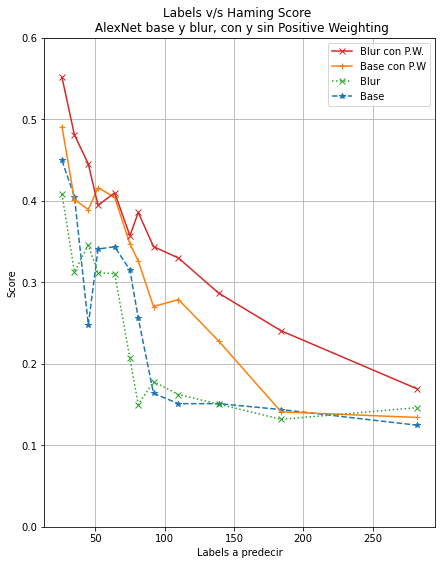

In [251]:
x = [26, 35, 45, 52, 64, 75, 81, 92, 110, 139, 184, 282]
hs_base_nw = [0.4493, 0.4048, 0.2478, 0.3407, 0.3434, 0.3150, 
              0.2560, 0.1637, 0.1510, 0.1510, 0.1438, 0.1246]
hs_base_pw = [0.4909, 0.4012, 0.3891, 0.4159, 0.4041, 0.3469,
              0.3259, 0.2701, 0.2787, 0.2278, 0.1410, 0.1341]
hs_blur_nw = [0.4079, 0.3128, 0.3453, 0.3117, 0.3104, 0.2066,
              0.1499, 0.1781, 0.1622, 0.1504, 0.1318, 0.1461]
hs_blur_pw = [0.5513, 0.4806, 0.4450, 0.3944, 0.4096, 0.3570,
              0.3855, 0.3436, 0.3296, 0.2865, 0.2404, 0.1692]
hs = [hs_base_nw, hs_base_pw, hs_blur_nw, hs_blur_pw]

labels = ["Base", "Base con P.W", "Blur", "Blur con P.W."]

plot_results(x,
             hscore = hs,
             label = labels,
             title = "Labels v/s Haming Score \n AlexNet base y blur, con y sin Positive Weighting",
            xlabel = "Labels a predecir", ylabel = "Score", order=[3, 1, 2, 0])

---

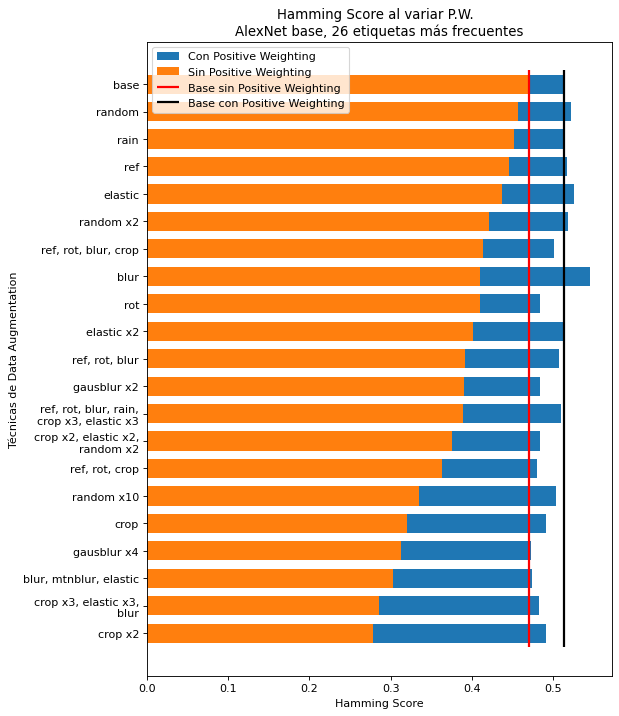

In [272]:
x = ['base', 'ref', 'rot', 'blur', 'crop', 'elastic', 'rain', 'random',
     'crop x2', 'elastic x2', 'random x2', 'ref, rot, blur', 'ref, rot, crop',
     'ref, rot, blur, crop', 'crop x2, elastic x2, random x2', 
     'crop x3, elastic x3, blur', 'ref, rot, blur, rain, crop x3, elastic x3',
     'random x10', 'gausblur x4', 'gausblur x2', 'blur, mtnblur, elastic']


hs_no_pw = [0.4698, 0.4454, 0.4092, 0.4097, 0.3205, 0.4372, 0.4509, 0.4563,
            0.2785, 0.4015, 0.4207, 0.3917, 0.3628, 0.4136, 0.3748, 0.2852,
            0.3888, 0.3352, 0.3121, 0.3898, 0.3021]
hs_pw = [0.5133, 0.5162, 0.4839, 0.5446, 0.4910, 0.5252, 0.5139, 0.5216,
         0.4906, 0.5125, 0.5181, 0.5064, 0.4797, 0.5012, 0.4833, 0.4822,
         0.5088, 0.5033, 0.4719, 0.4833, 0.4736]

# ordenar 
hs_no_pw, hs_pw, x = zip(*sorted(zip(hs_no_pw, hs_pw, x)))

# wrap de las etiquetas cuando exceden cierto largo
x = ['\n'.join(wrap(l, 22)) for l in x]

fig, ax = plt.subplots()
width = 1

ax.barh(x, hs_pw, width, label = 'Con Positive Weighting')
ax.barh(x, hs_no_pw, width, label = 'Sin Positive Weighting')

ax.set_xlabel('Hamming Score')
ax.set_ylabel('Técnicas de Data Augmentation')

ax.set_title('Hamming Score al variar P.W.  \nAlexNet base, 26 etiquetas más frecuentes')

# linea horizontal marcando el resultado base no pw
plt.vlines(x=0.4698, color='red', linewidth=2, ymin=-0.5, ymax=20.5, label = 'Base sin Positive Weighting')
plt.vlines(x=0.5133, color='black', linewidth=2, ymin=-0.5, ymax=20.5, label = 'Base con Positive Weighting')

# rotar labels del eje x
#plt.xticks(rotation=90)
fig.set_size_inches(7.5, 10.5)
fig.set_dpi(80)

# labels en orden deseado
handles, labels = plt.gca().get_legend_handles_labels()
order = [2, 3, 0, 1]
ax.legend([handles[idx] for idx in order],[labels[idx] for idx in order], loc="upper left")

plt.show()

---

Usando top_labels previamente generados para 26 labels
panel            289
horizontal       234
ornament         123
hatched          108
vertical         104
circle            80
metopal           77
filling           74
lozenge           64
enclosing         62
double            54
cross-hatched     51
triangle          49
line              42
chain             41
concentric        40
meander           40
bar               39
dotted            37
solid             35
dot               34
cross             31
outline           31
single            28
hook              27
floor             27
dtype: int64
0 53b


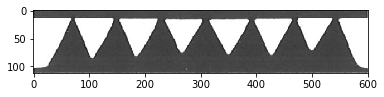

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel solid 


1 2b


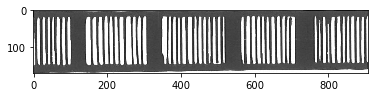

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical bar filling ornament 


2 40g


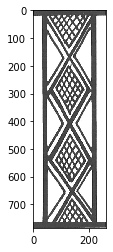

Labels correctos:
panel vertical cross-hatched outline lozenge chain 
Labels predichos:
panel vertical cross-hatched outline lozenge chain 


3 70h


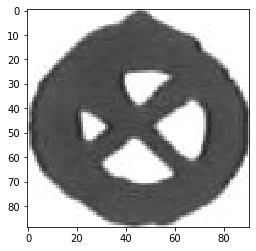

Labels correctos:
filling ornament 
Labels predichos:
enclosing filling ornament circle lozenge 


4 94a


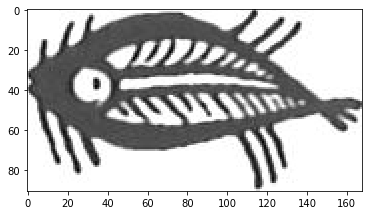

Labels correctos:
filling ornament hatched solid 
Labels predichos:
hatched 


5 3b


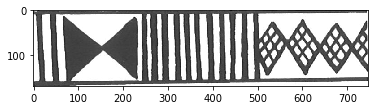

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical bar filling ornament 


6 60a


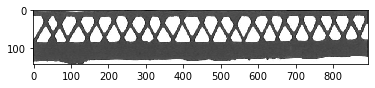

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel vertical bar 


7 61b


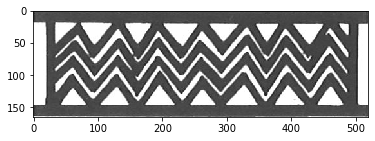

Labels correctos:
horizontal panel double 
Labels predichos:
horizontal panel double dotted dot lozenge chain 


8 86d


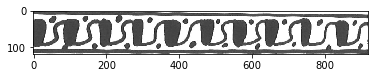

Labels correctos:
horizontal panel dot 
Labels predichos:
horizontal panel 


9 40e


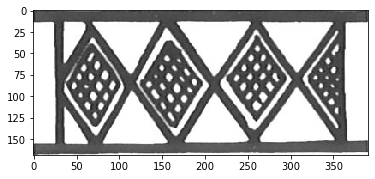

Labels correctos:
horizontal panel double cross-hatched outline lozenge chain 
Labels predichos:
horizontal panel hatched triangle solid double outline lozenge chain 


10 84a


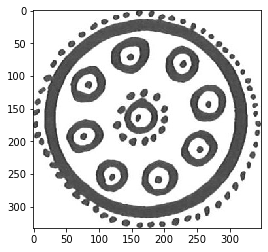

Labels correctos:
enclosing dotted circle outline 
Labels predichos:
enclosing metopal dotted circle outline 


11 5b


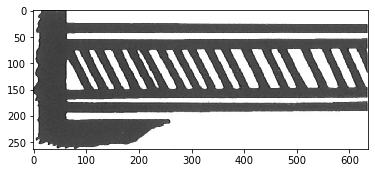

Labels correctos:
horizontal panel bar 
Labels predichos:
horizontal panel 


12 2i


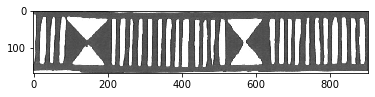

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical bar filling ornament 


13 39d


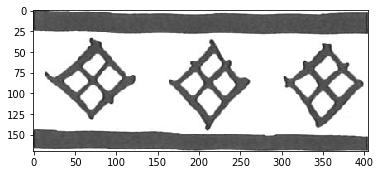

Labels correctos:
horizontal panel cross-hatched lozenge 
Labels predichos:
horizontal panel cross-hatched 


14 3e


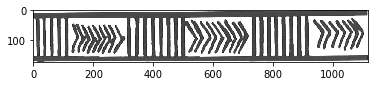

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical bar filling ornament 


15 92c


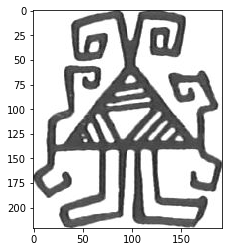

Labels correctos:
hook 
Labels predichos:
hook 


16 78j


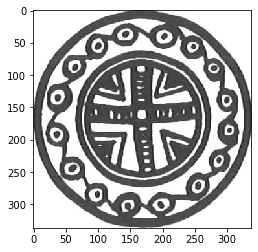

Labels correctos:
enclosing ornament cross hatched triangle circle floor 
Labels predichos:
enclosing ornament hatched circle chain floor 


17 64e


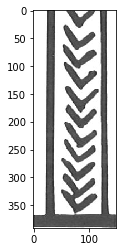

Labels correctos:
panel vertical 
Labels predichos:
panel vertical chain 


18 38b


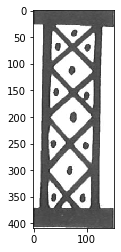

Labels correctos:
panel vertical dot lozenge chain 
Labels predichos:
panel vertical double dotted dot lozenge chain 


19 67b


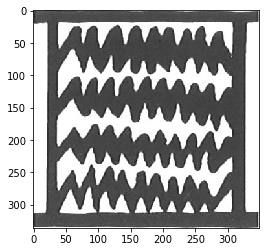

Labels correctos:
metopal 
Labels predichos:
metopal cross-hatched 


20 78g


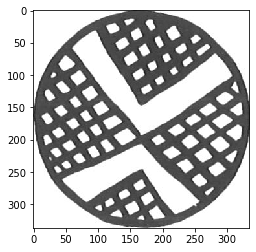

Labels correctos:
enclosing cross triangle cross-hatched circle 
Labels predichos:
enclosing ornament cross cross-hatched circle floor 


21 80e


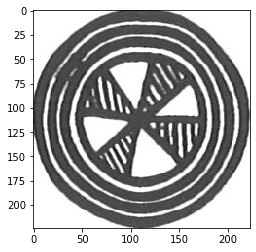

Labels correctos:
enclosing cross hatched concentric circle 
Labels predichos:
enclosing cross hatched concentric circle 


22 96e


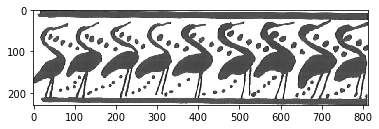

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel hatched 


23 44j


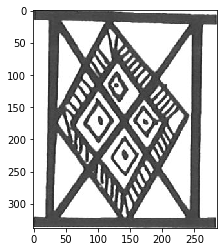

Labels correctos:
cross metopal hatched double dotted outline lozenge 
Labels predichos:
metopal cross-hatched lozenge 


24 64a


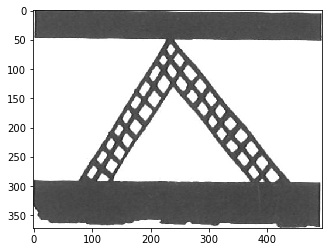

Labels correctos:
ornament single cross-hatched 
Labels predichos:
horizontal panel hatched triangle cross-hatched 


25 44f


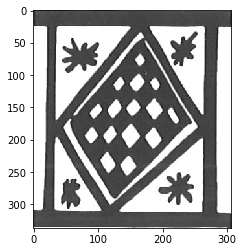

Labels correctos:
enclosing metopal double outline lozenge 
Labels predichos:
metopal cross-hatched lozenge 


26 11k


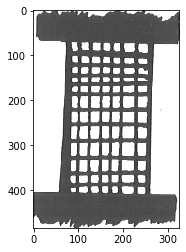

Labels correctos:
panel vertical cross-hatched 
Labels predichos:
panel vertical 


27 49c


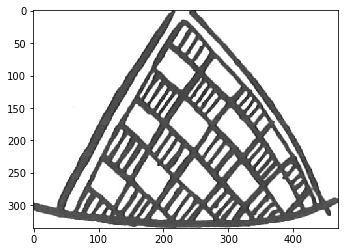

Labels correctos:
ornament triangle 
Labels predichos:
enclosing ornament triangle double dot outline lozenge 


28 36c


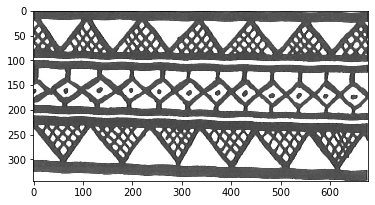

Labels correctos:
vertical bar lozenge 
Labels predichos:
triangle dotted cross-hatched lozenge chain 


29 16d


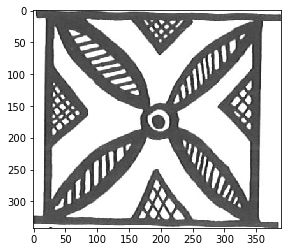

Labels correctos:
metopal hatched dotted circle 
Labels predichos:
metopal hatched 


30 28c


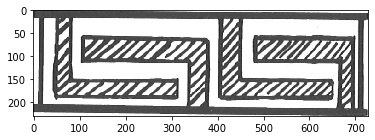

Labels correctos:
horizontal panel hatched hook meander 
Labels predichos:
horizontal panel hatched hook 


31 3h


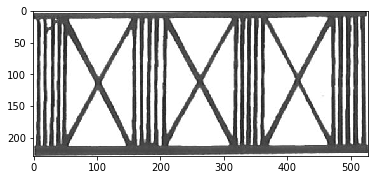

Labels correctos:
horizontal panel vertical bar cross 
Labels predichos:
horizontal panel hatched triangle concentric 


32 16h


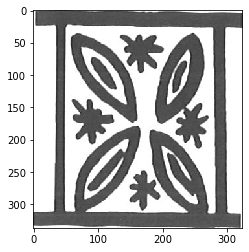

Labels correctos:
line metopal double single outline 
Labels predichos:
metopal hatched 


33 48h


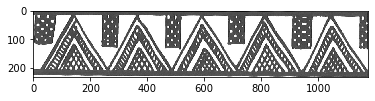

Labels correctos:
horizontal panel triangle cross-hatched outline 
Labels predichos:
horizontal panel hatched triangle double cross-hatched outline 


34 77a


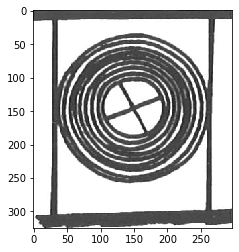

Labels correctos:
enclosing cross concentric circle 
Labels predichos:
enclosing cross metopal hatched concentric circle 


35 83f


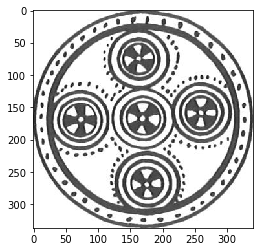

Labels correctos:
enclosing concentric circle 
Labels predichos:
enclosing concentric circle 


36 68d


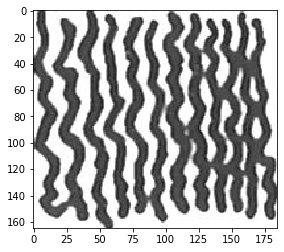

Labels correctos:
panel vertical 
Labels predichos:
panel vertical filling ornament 


37 36j


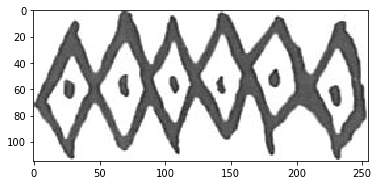

Labels correctos:
filling ornament dotted lozenge chain 
Labels predichos:
horizontal panel solid lozenge chain 


38 67e


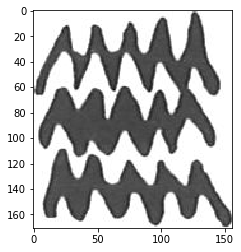

Labels correctos:
filling ornament 
Labels predichos:
enclosing filling solid lozenge 


39 31f


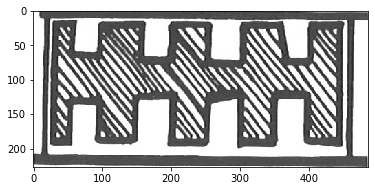

Labels correctos:
horizontal panel ornament hatched 
Labels predichos:
horizontal panel hatched 


40 40j


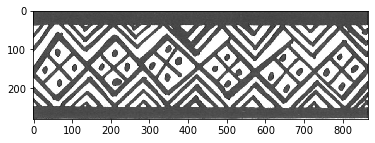

Labels correctos:
horizontal panel triangle dotted lozenge chain 
Labels predichos:
horizontal panel hatched triangle double cross-hatched lozenge chain 


41 93d


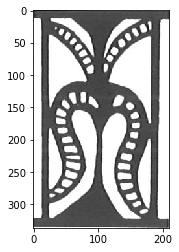

Labels correctos:

Labels predichos:
metopal 


42 6b


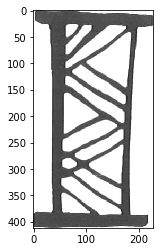

Labels correctos:
panel vertical 
Labels predichos:
panel vertical lozenge chain 


43 44l


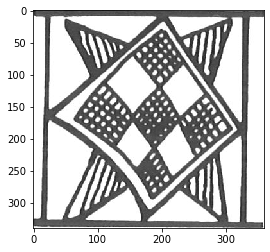

Labels correctos:
metopal lozenge 
Labels predichos:
metopal hatched triangle cross-hatched lozenge 


44 92f


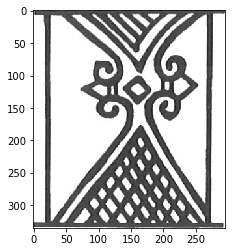

Labels correctos:
ornament metopal hatched cross-hatched 
Labels predichos:
metopal dotted 


45 28a


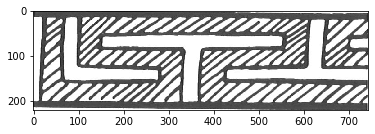

Labels correctos:
horizontal panel hatched 
Labels predichos:
horizontal panel hatched meander 


46 75c


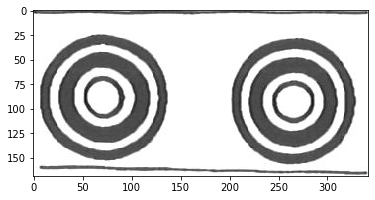

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel concentric circle 


47 38f


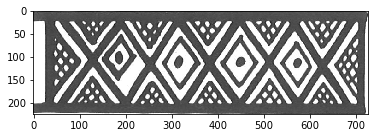

Labels correctos:
horizontal panel triangle double dotted lozenge chain 
Labels predichos:
horizontal panel hatched triangle cross-hatched lozenge 


48 70d


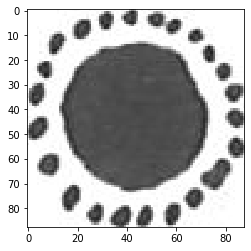

Labels correctos:
filling ornament dot 
Labels predichos:
enclosing filling ornament dot 


49 8g


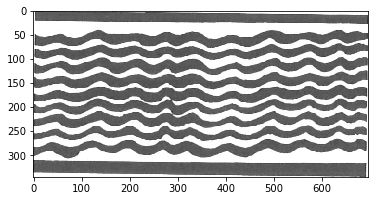

Labels correctos:
horizontal panel 
Labels predichos:
panel vertical ornament lozenge chain 


50 67h


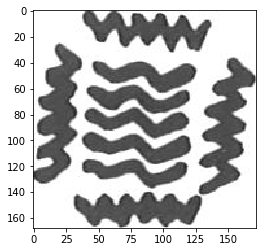

Labels correctos:
panel 
Labels predichos:
filling ornament dotted dot circle 


51 89b


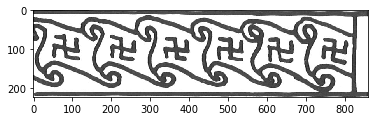

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel hatched double dotted 


52 48g


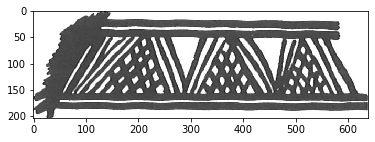

Labels correctos:
horizontal panel triangle cross-hatched outline 
Labels predichos:
horizontal panel hatched double outline 


53 57d


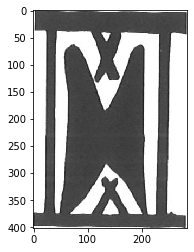

Labels correctos:
metopal solid double 
Labels predichos:
horizontal panel vertical metopal solid 


54 94e


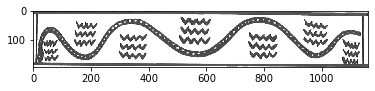

Labels correctos:
horizontal panel solid dot 
Labels predichos:
horizontal panel hatched hook 


55 62e


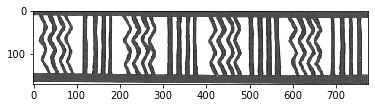

Labels correctos:
vertical 
Labels predichos:
horizontal panel vertical bar filling 


56 43h


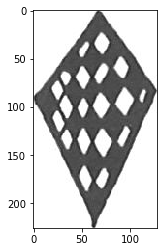

Labels correctos:
filling ornament lozenge 
Labels predichos:
filling ornament cross-hatched lozenge 


57 55e


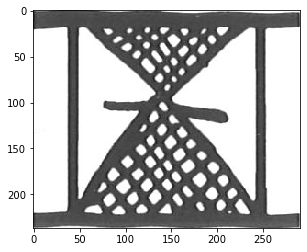

Labels correctos:
metopal cross-hatched 
Labels predichos:
metopal cross-hatched 


58 90g


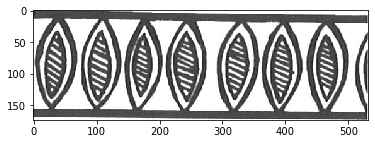

Labels correctos:
horizontal panel hatched double outline 
Labels predichos:
horizontal panel hatched double outline lozenge chain 


59 74d


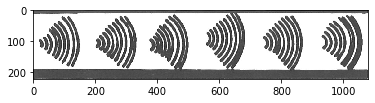

Labels correctos:
horizontal panel concentric 
Labels predichos:
horizontal panel vertical hatched 


60 11f


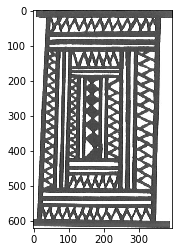

Labels correctos:
ornament 
Labels predichos:
vertical ornament 


61 91b


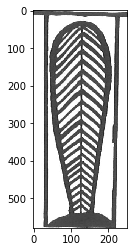

Labels correctos:
panel vertical filling 
Labels predichos:
panel vertical 


62 84i


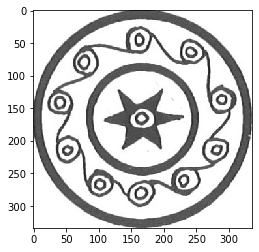

Labels correctos:
enclosing circle chain 
Labels predichos:
enclosing ornament dot circle outline chain floor 


63 49a


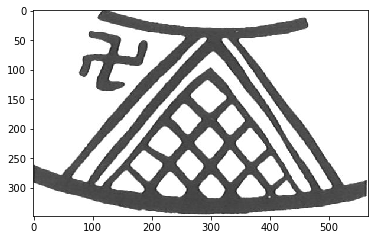

Labels correctos:
ornament triangle cross-hatched outline 
Labels predichos:
ornament triangle 


64 72g


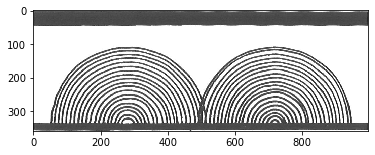

Labels correctos:
horizontal panel concentric 
Labels predichos:
horizontal panel concentric 


65 51b


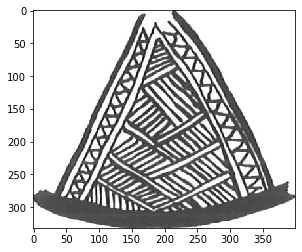

Labels correctos:
ornament triangle 
Labels predichos:
ornament triangle double dot outline lozenge 


66 49g


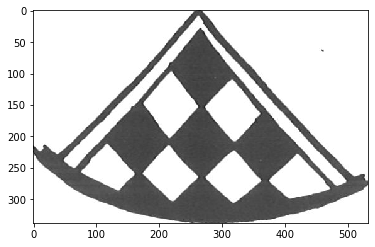

Labels correctos:
horizontal panel filling triangle 
Labels predichos:
enclosing ornament triangle solid lozenge 


67 91f


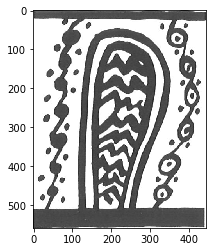

Labels correctos:
panel vertical filling 
Labels predichos:
panel vertical filling 


68 36k


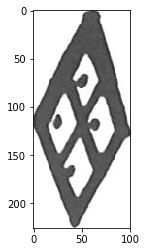

Labels correctos:
filling ornament dotted lozenge 
Labels predichos:
filling ornament dotted lozenge 


69 44d


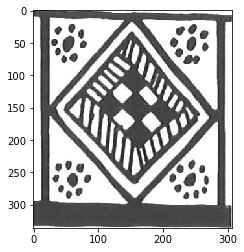

Labels correctos:
enclosing metopal double outline lozenge 
Labels predichos:
enclosing metopal cross-hatched outline lozenge 


70 41d


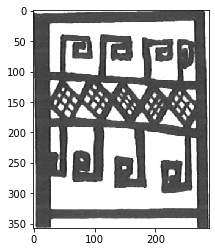

Labels correctos:
panel vertical hook cross-hatched lozenge chain 
Labels predichos:
metopal hatched hook 


71 50e


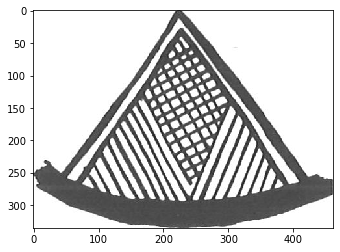

Labels correctos:
enclosing ornament triangle lozenge 
Labels predichos:
enclosing ornament triangle dot outline lozenge 


72 17h


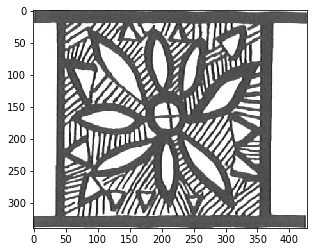

Labels correctos:
metopal hatched 
Labels predichos:
cross metopal hatched dotted 


73 8f


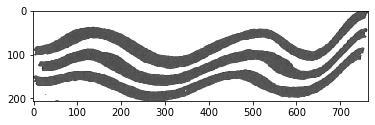

Labels correctos:
horizontal panel 
Labels predichos:
enclosing filling ornament lozenge 


74 35c


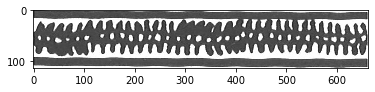

Labels correctos:
horizontal panel lozenge chain 
Labels predichos:
horizontal panel 


75 25c


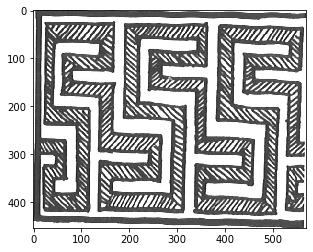

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched meander 


76 71g


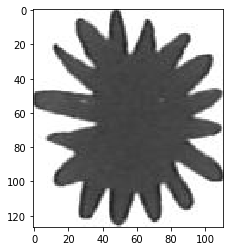

Labels correctos:
filling ornament 
Labels predichos:
filling ornament 


77 41c


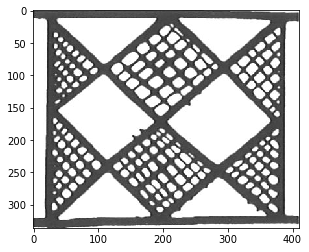

Labels correctos:
metopal cross-hatched 
Labels predichos:
metopal cross-hatched 


78 10b


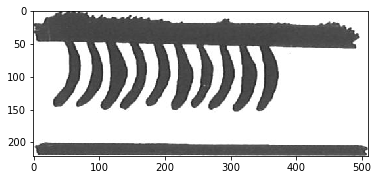

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel 


79 24b


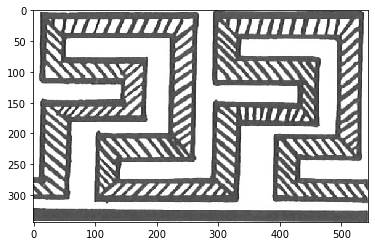

Labels correctos:
horizontal panel double meander 
Labels predichos:
horizontal panel hatched meander 


80 82d


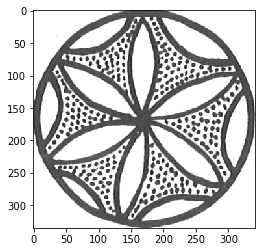

Labels correctos:
enclosing dotted circle 
Labels predichos:
enclosing ornament hatched circle floor 


81 77d


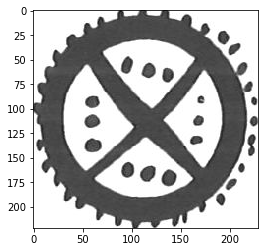

Labels correctos:
enclosing cross circle 
Labels predichos:
enclosing ornament cross dotted dot circle 


82 58f


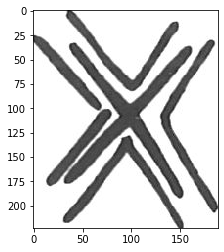

Labels correctos:
cross 
Labels predichos:
line cross metopal double 


83 34c


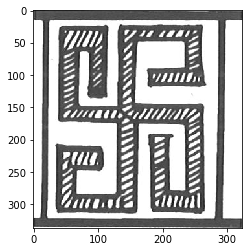

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched meander 


84 36l


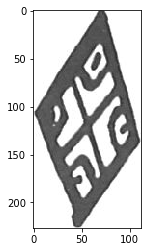

Labels correctos:
filling ornament dotted lozenge 
Labels predichos:
enclosing filling ornament cross-hatched lozenge 


85 93h


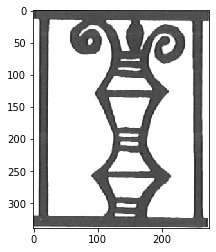

Labels correctos:

Labels predichos:
metopal 


86 25a


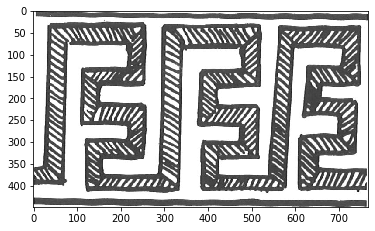

Labels correctos:
horizontal panel hatched double meander 
Labels predichos:
horizontal panel hatched double meander 


87 57e


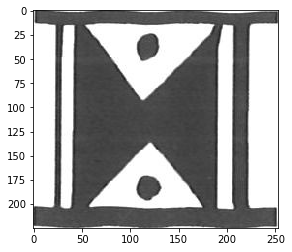

Labels correctos:
metopal solid double 
Labels predichos:
metopal solid 


88 30b


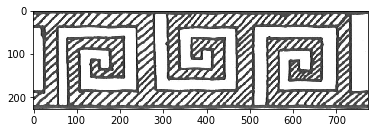

Labels correctos:
horizontal panel hatched hook meander 
Labels predichos:
horizontal panel hatched hook meander 


89 74c


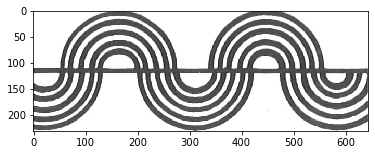

Labels correctos:
horizontal panel concentric 
Labels predichos:
horizontal panel concentric circle 


90 20h


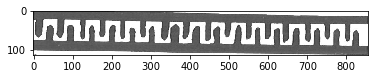

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel vertical bar lozenge chain 


91 44b


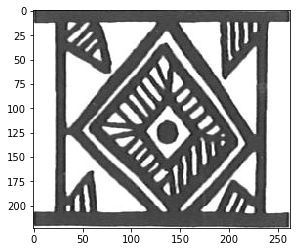

Labels correctos:
cross metopal hatched dot lozenge 
Labels predichos:
cross metopal hatched triangle cross-hatched lozenge 


92 63e


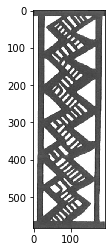

Labels correctos:
panel vertical hatched 
Labels predichos:
panel vertical triangle solid double cross-hatched lozenge chain 


93 89g


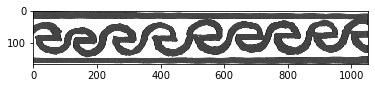

Labels correctos:
horizontal panel chain 
Labels predichos:
horizontal panel double dotted dot circle 


94 41e


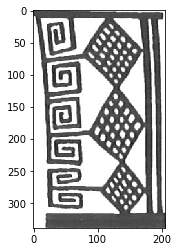

Labels correctos:
panel vertical hook cross-hatched lozenge chain 
Labels predichos:
metopal cross-hatched 


95 7c


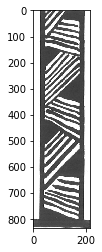

Labels correctos:
panel vertical triangle solid 
Labels predichos:
horizontal panel vertical bar filling ornament 


96 60f


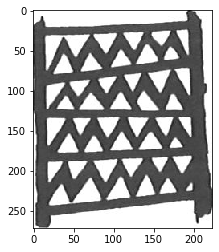

Labels correctos:
panel vertical line 
Labels predichos:
enclosing metopal solid lozenge 


97 27d


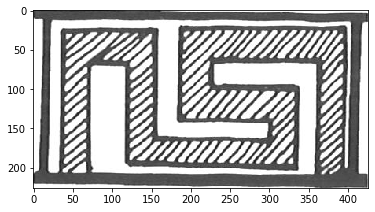

Labels correctos:
hatched single meander 
Labels predichos:
horizontal panel hatched 


98 57f


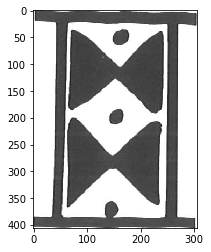

Labels correctos:
metopal solid double 
Labels predichos:
filling metopal 


99 55f


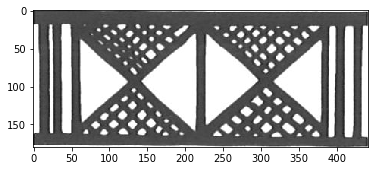

Labels correctos:
metopal cross-hatched 
Labels predichos:
metopal triangle cross-hatched 


100 17g


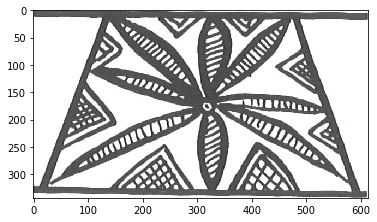

Labels correctos:
metopal hatched 
Labels predichos:
ornament cross metopal hatched 


101 47a


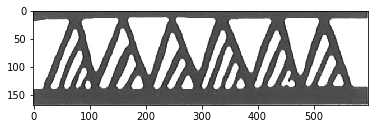

Labels correctos:
horizontal panel hatched triangle 
Labels predichos:
horizontal panel hatched triangle double outline 


102 4c


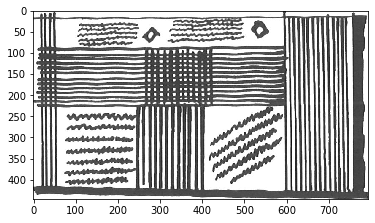

Labels correctos:
horizontal vertical bar 
Labels predichos:
horizontal panel vertical bar filling ornament 


103 27a


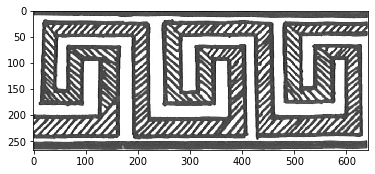

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched hook meander 


104 90f


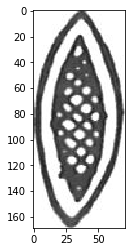

Labels correctos:
filling ornament double cross-hatched outline 
Labels predichos:
enclosing filling ornament cross-hatched circle lozenge chain 


105 25b


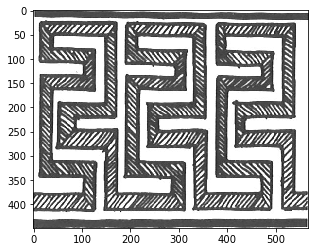

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched double meander 


106 34f


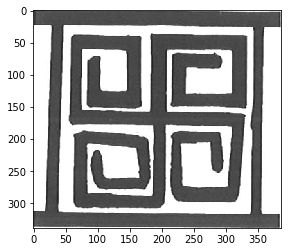

Labels correctos:
line metopal single 
Labels predichos:
metopal hatched 


107 65f


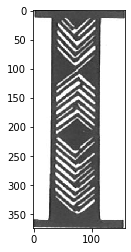

Labels correctos:
panel vertical filling solid 
Labels predichos:
panel vertical bar 


108 47f


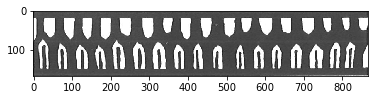

Labels correctos:
horizontal panel triangle 
Labels predichos:
horizontal panel bar 


109 76e


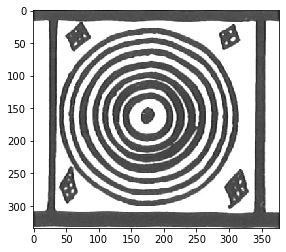

Labels correctos:
metopal concentric circle 
Labels predichos:
enclosing concentric circle 


110 56b


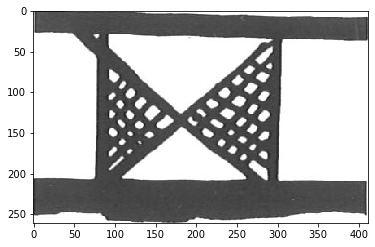

Labels correctos:
horizontal panel double cross-hatched 
Labels predichos:
metopal cross-hatched 


111 76g


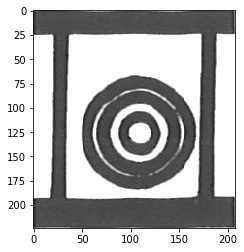

Labels correctos:
metopal concentric circle 
Labels predichos:
metopal concentric cross-hatched circle 


112 29f


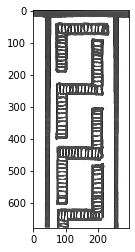

Labels correctos:
panel vertical hatched hook 
Labels predichos:
metopal hatched single 


113 66c


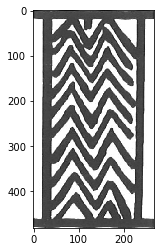

Labels correctos:
panel vertical 
Labels predichos:
vertical metopal 


114 75i


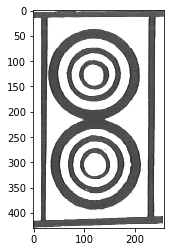

Labels correctos:
panel vertical concentric circle 
Labels predichos:
vertical enclosing concentric circle 


115 63a


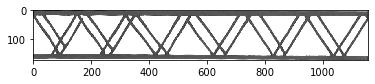

Labels correctos:
horizontal panel line double 
Labels predichos:
horizontal panel hatched triangle double outline 


116 56e


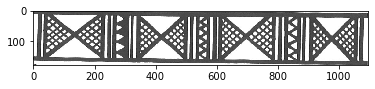

Labels correctos:
double cross-hatched 
Labels predichos:
horizontal panel hatched double cross-hatched lozenge chain 


117 59d


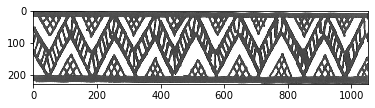

Labels correctos:
horizontal panel hatched 
Labels predichos:
horizontal panel hatched triangle cross-hatched 


118 95l


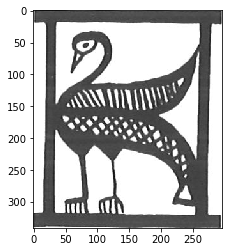

Labels correctos:
metopal hatched cross-hatched 
Labels predichos:
metopal hatched cross-hatched 


119 70j


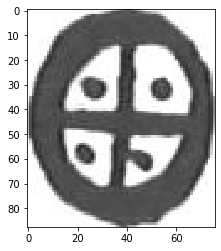

Labels correctos:
filling ornament 
Labels predichos:
enclosing line ornament cross concentric dot circle floor 


120 46i


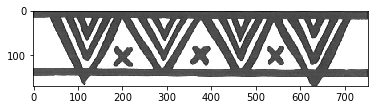

Labels correctos:
horizontal panel triangle concentric 
Labels predichos:
horizontal panel bar hatched 


121 34b


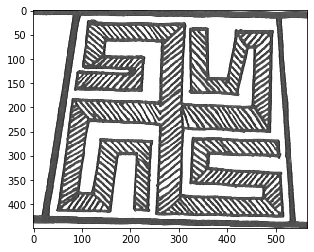

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched meander 


122 17d


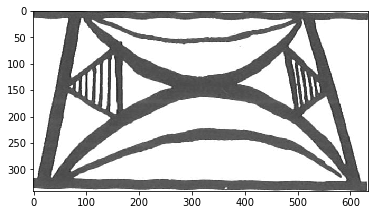

Labels correctos:
ornament metopal 
Labels predichos:
cross metopal hatched double 


123 61g


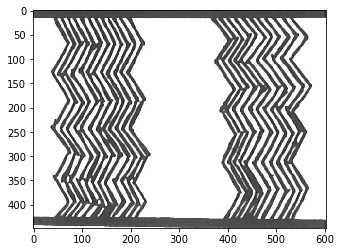

Labels correctos:
horizontal panel vertical 
Labels predichos:
horizontal panel hatched 


124 76j


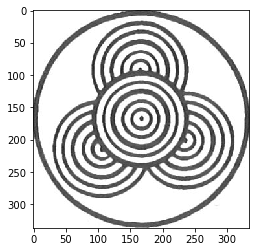

Labels correctos:
enclosing concentric circle 
Labels predichos:
enclosing concentric circle chain floor 


125 86b


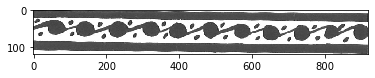

Labels correctos:
horizontal panel dot 
Labels predichos:
horizontal panel 


126 64g


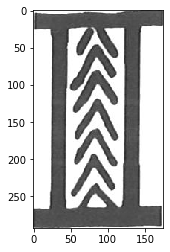

Labels correctos:
panel vertical 
Labels predichos:
panel vertical filling lozenge 


127 38i


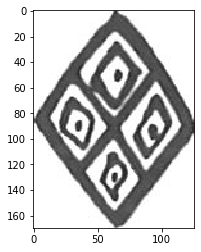

Labels correctos:
enclosing filling ornament dotted lozenge 
Labels predichos:
enclosing filling ornament cross-hatched lozenge 


128 3f


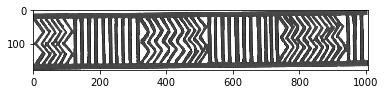

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical filling 


129 1e


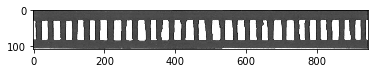

Labels correctos:
horizontal panel vertical bar 
Labels predichos:
horizontal panel vertical bar filling ornament 


130 71j


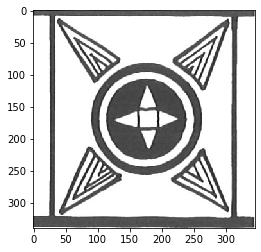

Labels correctos:
metopal triangle concentric circle 
Labels predichos:
metopal concentric 


131 96c


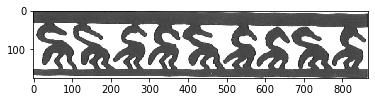

Labels correctos:
horizontal panel solid 
Labels predichos:
horizontal panel triangle cross-hatched 


132 27g


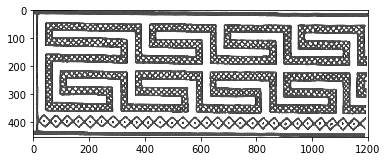

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched double meander 


133 13c


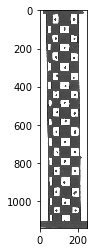

Labels correctos:
panel vertical dotted 
Labels predichos:
panel vertical bar 


134 37i


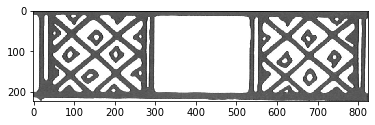

Labels correctos:
double lozenge 
Labels predichos:
horizontal panel hatched outline 


135 32b


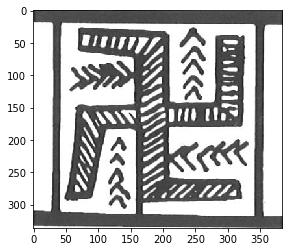

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched 


136 47d


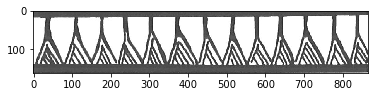

Labels correctos:
horizontal panel bar hatched triangle 
Labels predichos:
horizontal panel bar triangle 


137 92d


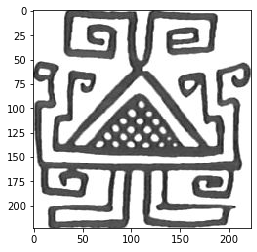

Labels correctos:
hook 
Labels predichos:
metopal hatched hook 


138 24d


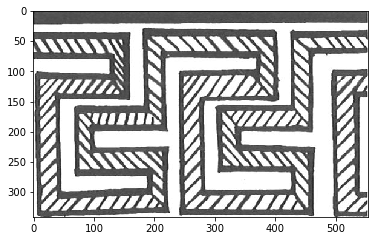

Labels correctos:
horizontal panel double meander 
Labels predichos:
horizontal panel hatched double meander 


139 96b


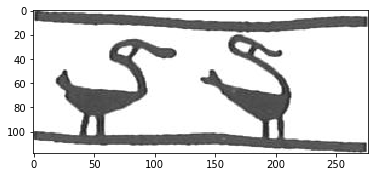

Labels correctos:
horizontal panel solid 
Labels predichos:
horizontal panel hatched 


140 20d


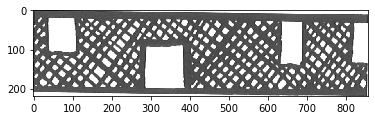

Labels correctos:
horizontal panel cross-hatched 
Labels predichos:
horizontal panel triangle cross-hatched 


141 48c


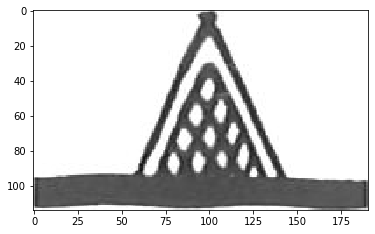

Labels correctos:
filling ornament triangle double cross-hatched outline 
Labels predichos:
enclosing ornament triangle 


142 21b


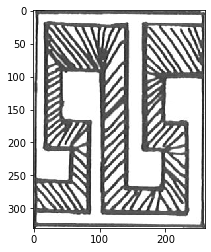

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
metopal hatched 


143 12f


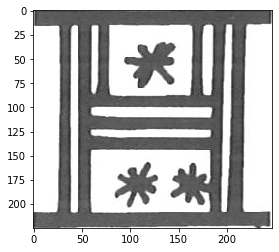

Labels correctos:

Labels predichos:
panel vertical metopal 


144 14g


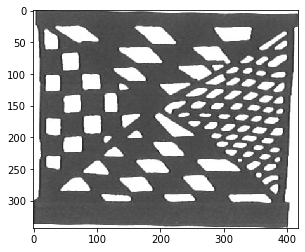

Labels correctos:
cross metopal 
Labels predichos:
vertical filling ornament triangle solid cross-hatched lozenge chain 


145 21a


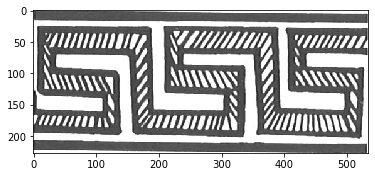

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched double meander 


146 81g


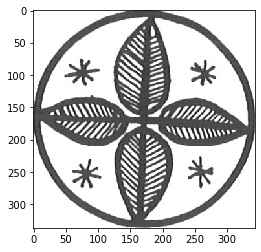

Labels correctos:
enclosing ornament circle floor 
Labels predichos:
enclosing ornament hatched circle floor 


147 44a


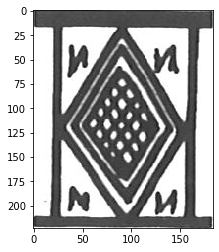

Labels correctos:
metopal cross-hatched outline lozenge 
Labels predichos:
metopal hatched cross-hatched lozenge 


148 36a


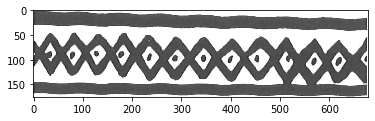

Labels correctos:
horizontal panel dotted lozenge chain 
Labels predichos:
horizontal panel cross-hatched dot lozenge chain 


149 54a


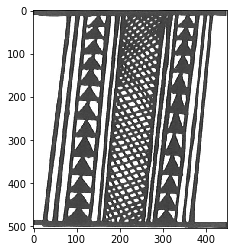

Labels correctos:
panel vertical triangle solid 
Labels predichos:
vertical filling ornament concentric 


150 31g


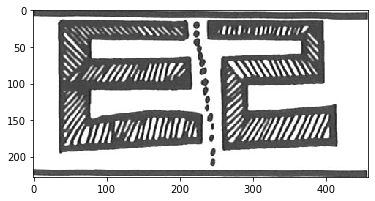

Labels correctos:
horizontal ornament 
Labels predichos:
horizontal panel hatched hook meander 


151 85c


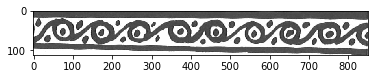

Labels correctos:
horizontal panel dotted dot circle 
Labels predichos:
horizontal panel double dotted dot circle 


152 92b


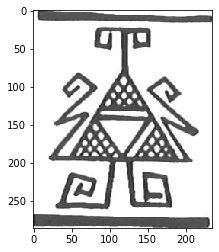

Labels correctos:
hook 
Labels predichos:
hook 


153 71a


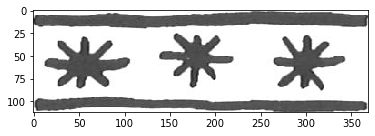

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel 


154 81j


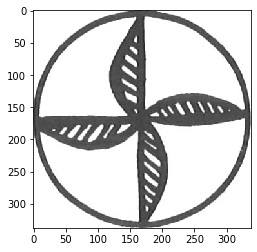

Labels correctos:
enclosing ornament hatched circle floor 
Labels predichos:
enclosing ornament cross circle floor 


155 75h


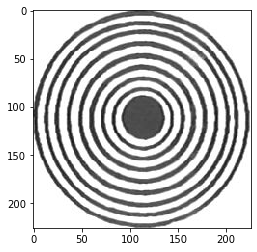

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
enclosing cross concentric circle 


156 73a


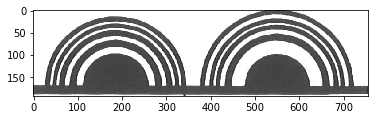

Labels correctos:
horizontal panel solid concentric 
Labels predichos:
horizontal panel concentric circle 


157 81d


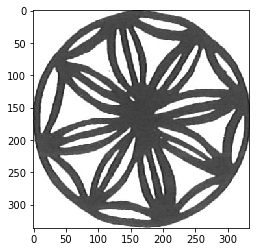

Labels correctos:
enclosing ornament circle floor 
Labels predichos:
enclosing line ornament hatched circle outline floor 


158 57k


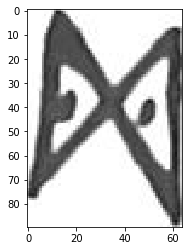

Labels correctos:
filling ornament double 
Labels predichos:
line filling ornament 


159 7d


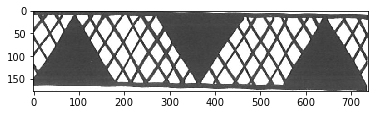

Labels correctos:
horizontal panel triangle solid 
Labels predichos:
horizontal panel vertical bar ornament triangle 


160 45a


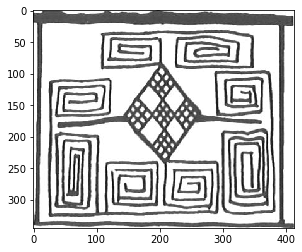

Labels correctos:
hook 
Labels predichos:
horizontal outline 


161 21d


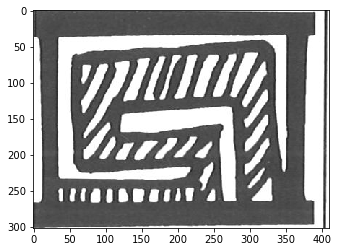

Labels correctos:
hatched single meander 
Labels predichos:
horizontal panel hatched hook 


162 39f


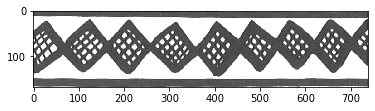

Labels correctos:
horizontal panel cross-hatched lozenge chain 
Labels predichos:
horizontal panel cross-hatched lozenge chain 


163 29a


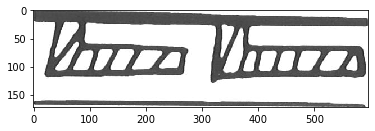

Labels correctos:
horizontal panel hatched hook 
Labels predichos:
horizontal panel line 


164 32d


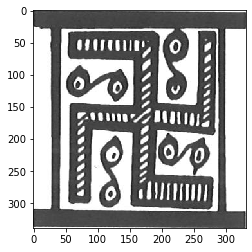

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched 


165 47i


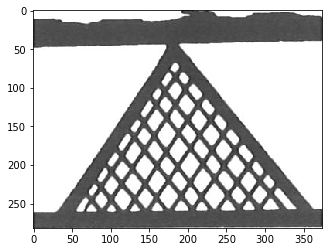

Labels correctos:
horizontal panel triangle cross-hatched 
Labels predichos:
hatched triangle cross-hatched 


166 80d


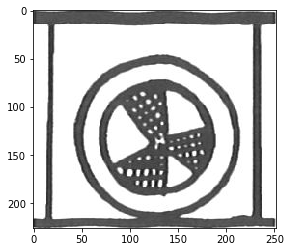

Labels correctos:
enclosing metopal concentric cross-hatched circle 
Labels predichos:
enclosing metopal concentric cross-hatched circle 


167 75k


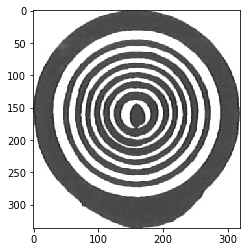

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
enclosing concentric circle 


168 80a


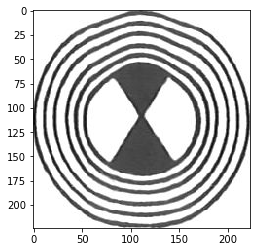

Labels correctos:
enclosing solid concentric circle 
Labels predichos:
enclosing cross hatched concentric circle 


169 78c


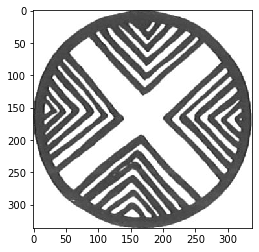

Labels correctos:
enclosing ornament cross circle floor 
Labels predichos:
enclosing ornament cross circle floor 


170 82e


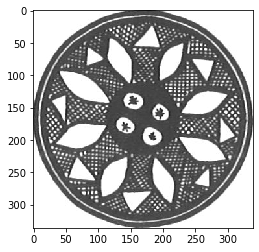

Labels correctos:
enclosing cross-hatched circle 
Labels predichos:
enclosing ornament hatched cross-hatched circle floor 


171 43d


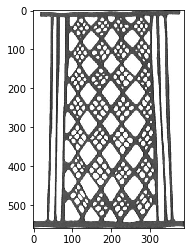

Labels correctos:
panel vertical cross-hatched lozenge 
Labels predichos:
vertical metopal cross-hatched 


172 74b


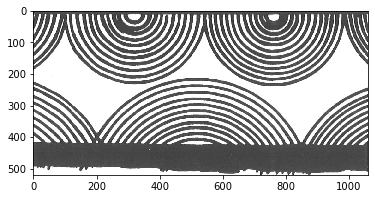

Labels correctos:
concentric 
Labels predichos:
horizontal panel concentric 


173 61d


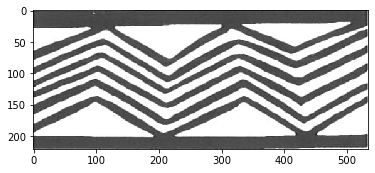

Labels correctos:
horizontal panel 
Labels predichos:
enclosing cross metopal hatched lozenge 


174 87f


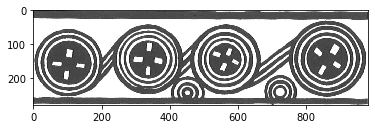

Labels correctos:
horizontal panel enclosing cross circle 
Labels predichos:
horizontal panel hatched double concentric circle 


175 40h


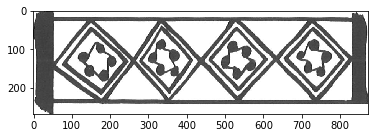

Labels correctos:
horizontal panel enclosing double circle outline lozenge chain 
Labels predichos:
horizontal panel hatched double outline lozenge chain 


176 9d


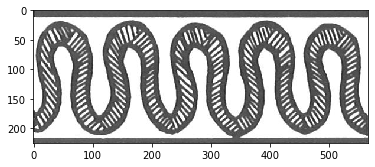

Labels correctos:
horizontal panel hatched 
Labels predichos:
horizontal panel hatched triangle 


177 45d


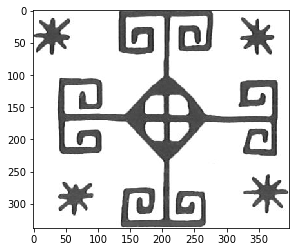

Labels correctos:
hook 
Labels predichos:
metopal hatched hook 


178 39i


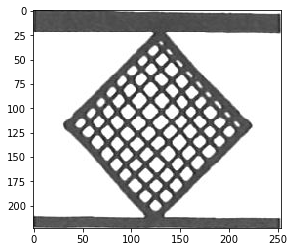

Labels correctos:
filling ornament cross-hatched lozenge 
Labels predichos:
filling ornament triangle cross-hatched lozenge 


179 44e


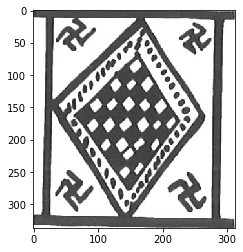

Labels correctos:
enclosing metopal double outline lozenge 
Labels predichos:
metopal hatched cross-hatched lozenge 


180 17f


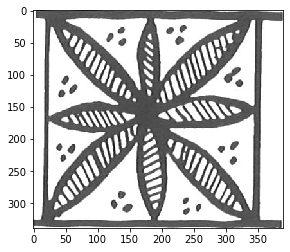

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched 


181 36g


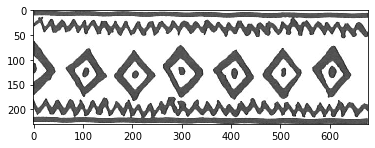

Labels correctos:
horizontal panel dotted lozenge 
Labels predichos:
horizontal panel hatched 


182 35e


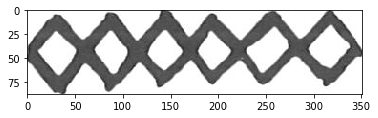

Labels correctos:
horizontal filling ornament lozenge chain 
Labels predichos:
horizontal panel filling solid lozenge 


183 36i


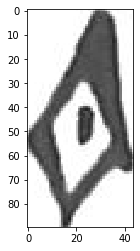

Labels correctos:
filling ornament dotted lozenge 
Labels predichos:
filling ornament lozenge 


184 35g


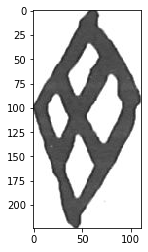

Labels correctos:
filling ornament lozenge 
Labels predichos:
filling ornament lozenge 


185 23a


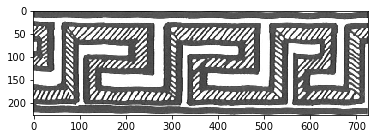

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched hook meander 


186 18e


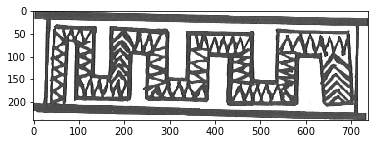

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel hatched 


187 16f


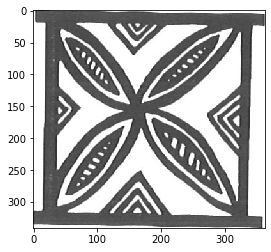

Labels correctos:
metopal hatched double outline 
Labels predichos:
cross metopal hatched 


188 70i


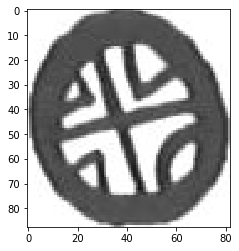

Labels correctos:
filling ornament 
Labels predichos:
enclosing line ornament cross circle floor 


189 79e


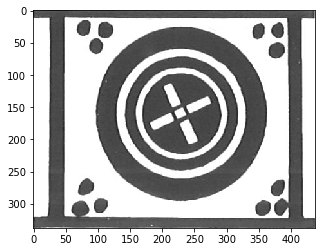

Labels correctos:
enclosing cross concentric circle 
Labels predichos:
enclosing metopal concentric circle 


190 19g


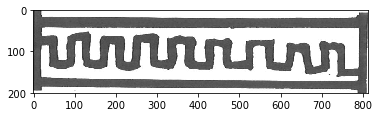

Labels correctos:
horizontal panel line single 
Labels predichos:
horizontal panel line single meander 


191 28j


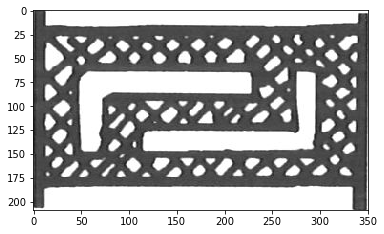

Labels correctos:
single hook cross-hatched meander 
Labels predichos:
horizontal panel hatched cross-hatched meander 


192 82j


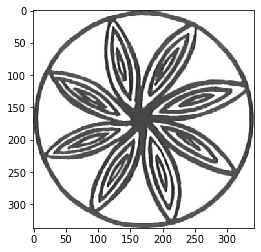

Labels correctos:
enclosing ornament circle outline floor 
Labels predichos:
enclosing ornament hatched double circle outline floor 


193 28g


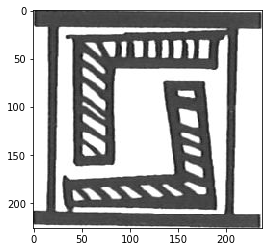

Labels correctos:
metopal hatched single hook meander 
Labels predichos:
horizontal panel metopal hatched 


194 75g


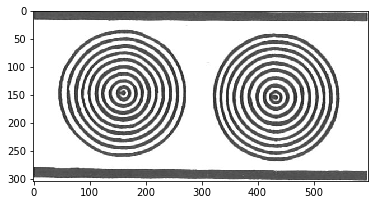

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel concentric circle 


195 76b


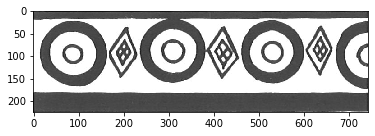

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel double dotted circle 


196 67g


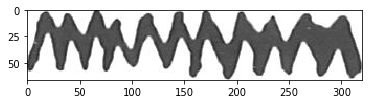

Labels correctos:
filling ornament 
Labels predichos:
horizontal panel vertical dot 


197 46j


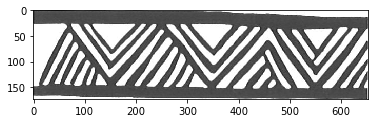

Labels correctos:
horizontal panel triangle concentric 
Labels predichos:
horizontal panel hatched triangle 


198 91h


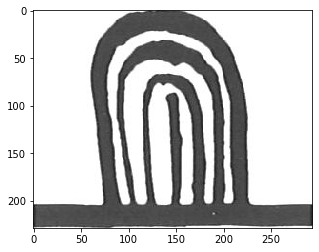

Labels correctos:
line filling ornament 
Labels predichos:
panel vertical filling ornament 


199 47c


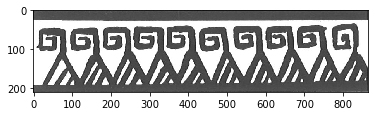

Labels correctos:
horizontal panel hatched triangle hook 
Labels predichos:
horizontal panel hatched triangle 


200 76d


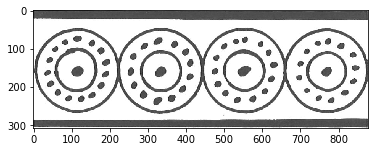

Labels correctos:
horizontal panel double dot circle chain 
Labels predichos:
horizontal panel hatched double dot circle 


201 62f


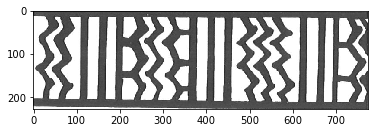

Labels correctos:
bar 
Labels predichos:
horizontal panel vertical bar 


202 72a


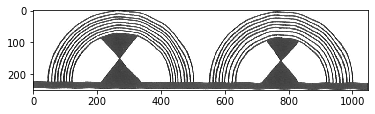

Labels correctos:
horizontal panel concentric 
Labels predichos:
horizontal panel vertical bar concentric 


203 61a


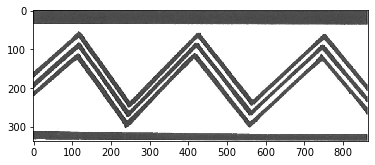

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel triangle double concentric outline 


204 80g


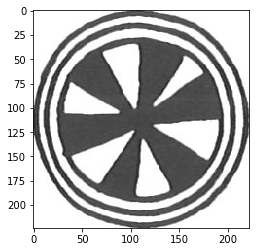

Labels correctos:
solid 
Labels predichos:
enclosing hatched concentric circle floor 


205 32c


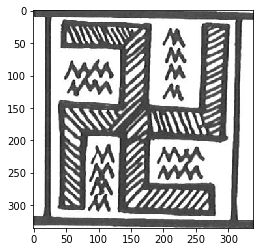

Labels correctos:
metopal hatched 
Labels predichos:
metopal hatched 


206 40i


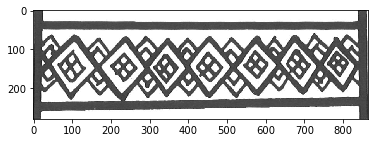

Labels correctos:
horizontal panel double lozenge chain 
Labels predichos:
horizontal panel bar double cross-hatched dot lozenge 


207 81e


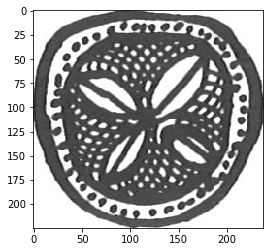

Labels correctos:
enclosing cross-hatched circle 
Labels predichos:
enclosing ornament cross-hatched circle floor 


208 70q


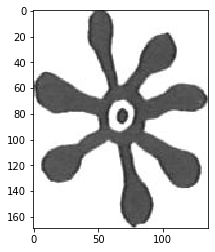

Labels correctos:
filling ornament solid 
Labels predichos:
filling ornament cross hatched 


209 82a


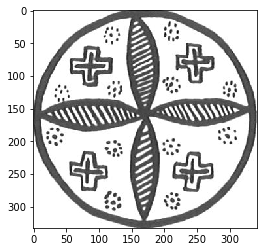

Labels correctos:
enclosing ornament hatched circle floor 
Labels predichos:
enclosing ornament hatched circle floor 


210 59g


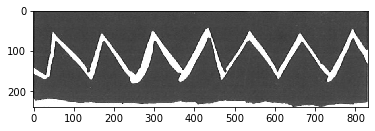

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel single 


211 95c


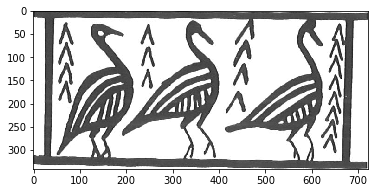

Labels correctos:
horizontal panel hatched 
Labels predichos:
horizontal panel metopal hatched 


212 70k


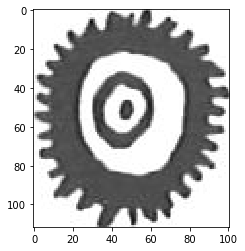

Labels correctos:
filling ornament 
Labels predichos:
filling ornament concentric 


213 87b


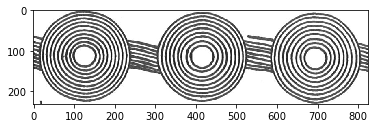

Labels correctos:
horizontal panel circle 
Labels predichos:
horizontal panel concentric circle 


214 21e


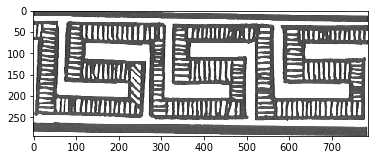

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel hatched double meander 


215 61f


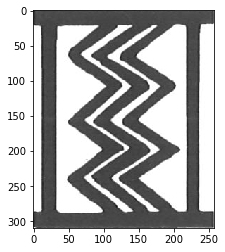

Labels correctos:
panel vertical 
Labels predichos:
panel vertical lozenge chain 


216 12b


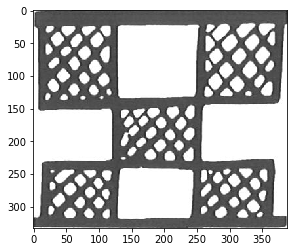

Labels correctos:
metopal 
Labels predichos:
metopal hatched cross-hatched 


217 16g


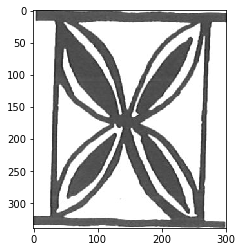

Labels correctos:
metopal solid double outline 
Labels predichos:
metopal hatched double outline 


218 42b


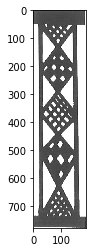

Labels correctos:
panel vertical cross-hatched lozenge chain 
Labels predichos:
panel vertical triangle solid cross-hatched lozenge chain 


219 78i


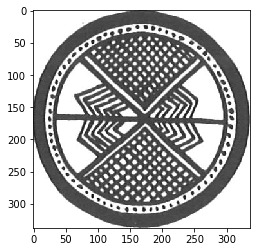

Labels correctos:
enclosing ornament triangle cross-hatched dot circle floor 
Labels predichos:
enclosing ornament cross-hatched circle floor 


220 44p


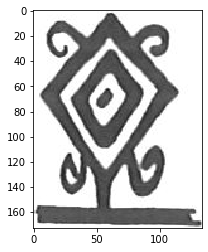

Labels correctos:
filling ornament lozenge 
Labels predichos:
filling ornament lozenge 


221 53g


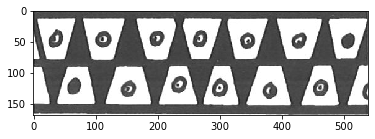

Labels correctos:
horizontal panel dot 
Labels predichos:
horizontal panel dot 


222 78k


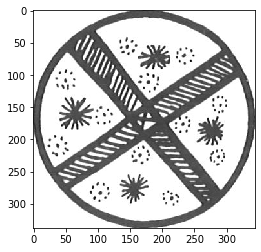

Labels correctos:
enclosing ornament cross hatched circle floor 
Labels predichos:
enclosing ornament hatched circle floor 


223 47k


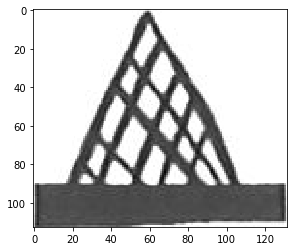

Labels correctos:
filling ornament triangle cross-hatched 
Labels predichos:
enclosing filling ornament triangle lozenge 


224 62b


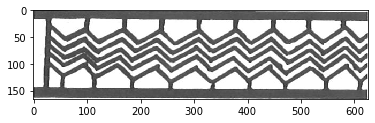

Labels correctos:
horizontal panel vertical bar 
Labels predichos:
horizontal panel bar hatched triangle double cross-hatched lozenge 


225 75j


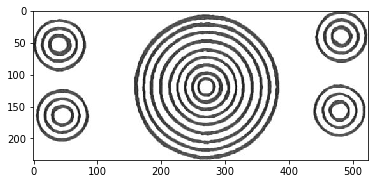

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel vertical concentric circle 


226 91d


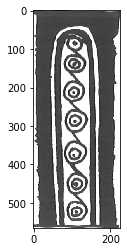

Labels correctos:
panel vertical filling 
Labels predichos:
panel vertical dot 


227 77f


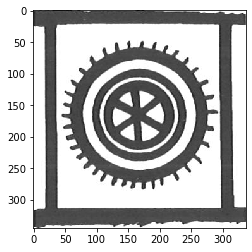

Labels correctos:
enclosing line metopal circle 
Labels predichos:
metopal concentric circle 


228 8e


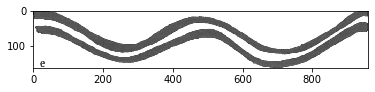

Labels correctos:
horizontal panel double 
Labels predichos:
enclosing cross metopal triangle 


229 77c


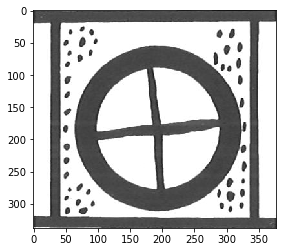

Labels correctos:
enclosing cross circle 
Labels predichos:
enclosing cross metopal hatched concentric circle 


230 16m


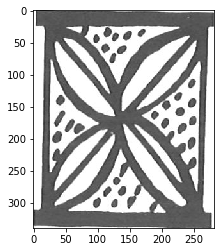

Labels correctos:
metopal dotted 
Labels predichos:
cross metopal hatched dotted 


231 70n


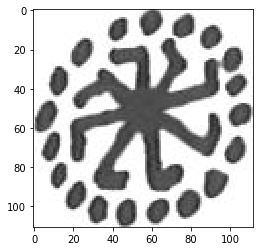

Labels correctos:
enclosing filling ornament dotted circle 
Labels predichos:
enclosing filling ornament dotted dot circle 


232 69e


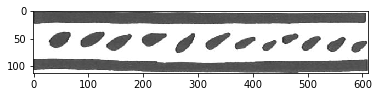

Labels correctos:
horizontal panel 
Labels predichos:
horizontal panel 


233 7a


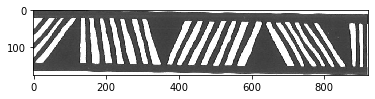

Labels correctos:
horizontal panel triangle solid 
Labels predichos:
horizontal panel vertical bar filling ornament 




In [43]:
# load labels 
labels_val = pd.read_json(os.path.join(labels_path, 'val_df.json'), orient='index')
labels_test = pd.read_json(os.path.join(labels_path, 'test_df.json'), orient='index')

# get N top labels
train_labels = pd.read_json(os.path.join(labels_path, 'augmented_train_df.json'), orient='index')
if not os.path.isfile(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle')):
    print(f"Creando top_labels para {NUM_LABELS} labels")
    top_labels, _ = filter_labels(train_labels, number_labels = NUM_LABELS)
    save = input(f"Se creará un archivo nuevo para {len(top_labels)} labels. Desea continuar? (y/n)")
    if save == "y":
        with open(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'), 'wb') as f:
            pickle.dump(top_labels, f)
        print(top_labels)
    else:
        raise Exception("No se logró cargar top_labels")
else:
    print(f"Usando top_labels previamente generados para {NUM_LABELS} labels")
    with open(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'), 'rb') as f:
        top_labels = pickle.load(f)
    print(top_labels)
    
labels_frame = filter_dfs(labels_test, top_labels)

# load images
for i, idx in enumerate(labels_frame.index.values, 0):
    print(i, idx)
    img_id = labels_frame.loc[idx].name + '.png'
    img_name = None
    for chapter in os.listdir(os.path.join(patterns_path, 'test')):
      if img_id in os.listdir(os.path.join(patterns_path, 'test', chapter)):
        img_name = os.path.join(patterns_path, 'test', chapter, img_id)
        break
    # caso test-val
    if img_name is None:
      for chapter in os.listdir(os.path.join(patterns_path, 'val')):
        if img_id in os.listdir(os.path.join(patterns_path, 'val', chapter)):
          img_name = os.path.join(patterns_path, 'val', chapter, img_id)
          break
    if img_name is None:
      raise Exception(f'No se encontró la imagen para {img_id}')
    image = Image.open(img_name)
    image = image.convert('RGB')
    image = np.array(image)
    labels = labels_frame.loc[idx].values
    labels = np.array(labels)
    preds = predictions[i]
    
    img = image.reshape(-1, image.shape[1], 3) # imagen j 
    plt.imshow(img, interpolation='nearest')
    plt.show()
    labels_correctos = ""
    labels_predichos = ""
    for k in range(0, len(preds)):
      labels_correctos += (labels_frame.columns.values[k]+' ') if labels[k] else ""
      labels_predichos += (labels_frame.columns.values[k]+' ') if preds[k] else ""
    print("Labels correctos:")
    print(labels_correctos)
    print("Labels predichos:")
    print(labels_predichos)
    print("\n")


Usando top_labels previamente generados para 286 labels
panel          289
horizontal     234
ornament       123
hatched        108
vertical       104
              ... 
intertwined      1
quadruple        1
downwards        1
wind             1
dash             1
Length: 282, dtype: int64
0 53b


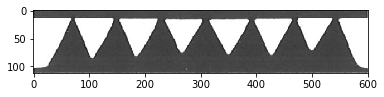

Labels correctos:
horizontal panel pointing upwards dogtooth 
Labels predichos:
horizontal panel line triangle solid double single hook lightning cross-hatched dot outline lozenge chain pointing accompanied ax 


1 2b


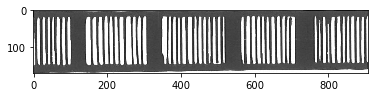

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel vertical bar enclosing line filling ornament opposed diagonal triangle separated solid single cross-hatched zigzag dogtooth semicircle 


2 40g


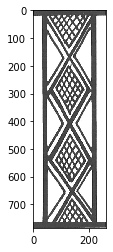

Labels correctos:
panel vertical triple cross-hatched outline lozenge chain 
Labels predichos:
panel vertical metopal hatched triangle stacked double triple multiple dotted cross-hatched dot outline lozenge chain tree outside rhodian scribble 


3 70h


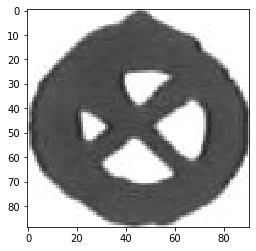

Labels correctos:
filling ornament quartered rosette 
Labels predichos:
line filling ornament small solid wavy double single rectangle dotted quarter cross-bar star dot circle swastika acute-angled rosette spiked eight-armed floor four-spoked wheel 


4 94a


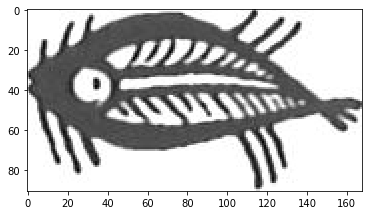

Labels correctos:
filling ornament hatched solid fish 
Labels predichos:
horizontal panel enclosing filling ornament andrew's cross chevron pattern metopal hatched triangle large solid double cross-hatched outline lozenge leaf filled windmill fish body 


5 3b


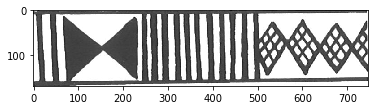

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel group vertical bar enclosing line filling ornament alternating hatched triangle solid double half concentric cross-hatched checkerboard zigzag 


6 60a


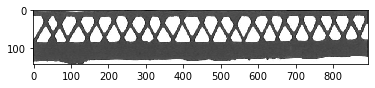

Labels correctos:
horizontal panel simple zigzag 
Labels predichos:
horizontal panel line filling ornament opposed diagonal triangle solid double single cross-hatched star lozenge pointing zigzag dogtooth ax 


7 61b


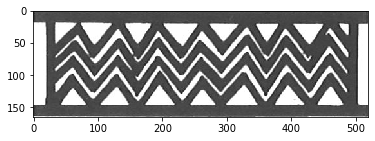

Labels correctos:
horizontal panel double triple multiple parallel zigzag 
Labels predichos:
horizontal panel bar hatched triangle apex field solid double triple parallel dotted cross-hatched checkerboarded dot outline lozenge chain two-tiered net leaf metopes side cross-hathed zigzag ax cut sigma turned four-limbed scribble 


8 86d


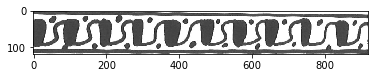

Labels correctos:
horizontal panel dot tangential blob elongated 
Labels predichos:
horizontal panel floating line right left hatched double single hook dotted cross-hatched dot lozenge battlement gear-pattern formed meander chain separate alternatively two-tiered net row slack leaf three-tiered four-tiered ax facing sigma turned four-limbed scribble 


9 40e


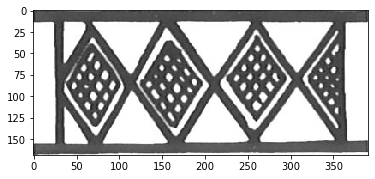

Labels correctos:
horizontal panel double cross-hatched outline lozenge chain 
Labels predichos:
horizontal panel diagonal hatched triangle solid double triple dotted cross-hatched checkerboard centre checkerboarded dot circle outline lozenge chain net spaced leaf side form zigzag scribble 


10 84a


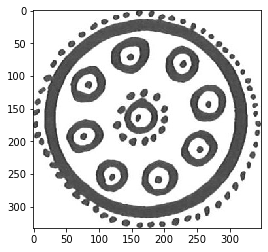

Labels correctos:
enclosing small dotted circle outline 
Labels predichos:
enclosing ornament metopal hatched multiple concentric dotted cross-hatched cruciform star dot quatrefoil circle outline arrangement chain tangential zigzag rosette flower floor point maltese seven-leaved 


11 5b


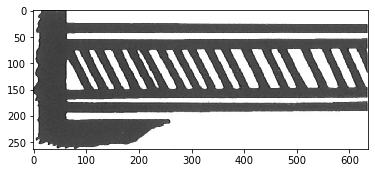

Labels correctos:
horizontal panel bar diagonally left 
Labels predichos:
horizontal panel group bar line filling ornament opposed hatched triangle solid double single concentric cross-hatched double-decker metope formed dogtooth semicircle 


12 2i


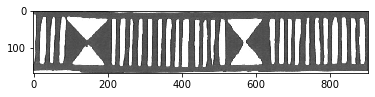

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel group vertical bar enclosing shorter line filling ornament alternating right opposed diagonal triangle separated solid double single cross-hatched wolftooth star careless zigzag ax 


13 39d


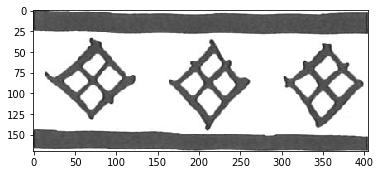

Labels correctos:
horizontal panel floating cross-hatched lozenge row 
Labels predichos:
horizontal panel line filling ornament chevron oblique hatched triangle small band double single cross-hatched dot circle swastika row spaced tangential zigzag spiral running 


14 3e


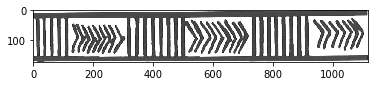

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel group vertical bar enclosing shorter line filling ornament alternating diagonally right left opposed diagonal triangle separated solid single cross-hatched checkerboard wolftooth star simplified careless zigzag ax facing three-limbed sigma turned scribble 


15 92c


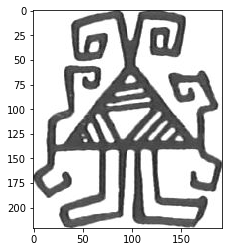

Labels correctos:
hook rectilinear figure 
Labels predichos:
cross composition metopal hatched solid hook cross-hatched metope circle rectilinear inverted confronted figure body bird 


16 78j


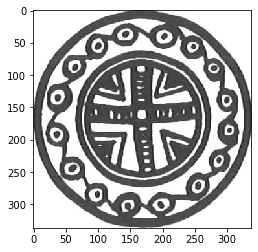

Labels correctos:
enclosing ornament cross hatched triangle spandrel circle floor 
Labels predichos:
enclosing ornament cross metopal hatched multiple concentric dotted cross-hatched cruciform star dot quatrefoil circle outline reserved arrangement chain tangential zigzag rosette flower floor point twelve-leaved seven-leaved circular 


17 64e


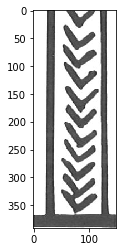

Labels correctos:
panel vertical floating 
Labels predichos:
panel vertical right left inclined stack oblique half-lines double triple multiple dotted dot outline lozenge chain tree tangential blob zigzag flanking tangets volute 


18 38b


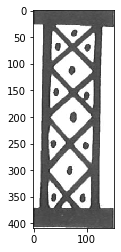

Labels correctos:
panel vertical dot lozenge chain 
Labels predichos:
panel vertical stack hatched solid double multiple dotted cross-hatched dot outline lozenge chain tree tangential scribble volute 


19 67b


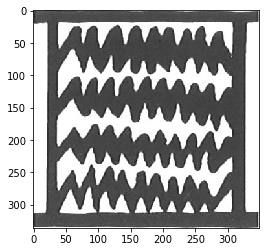

Labels correctos:
metopal stacked multiple scribble 
Labels predichos:
horizontal panel vertical filling pattern metopal hatched triangle apex solid multiple hook parallel cross-hatched checkerboard neck lozenge checked meander chain swastika net leaf zigzag tongue body bird long 


20 78g


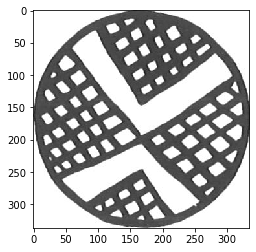

Labels correctos:
enclosing cross triangle cross-hatched circle reserved 
Labels predichos:
enclosing line ornament hatched double triple dotted cross-hatched star spandrel dot quatrefoil circle outline reserved background surrounded hexafoil octofoil swastika rosette floor eleven-pointed fan wing midrib 


21 80e


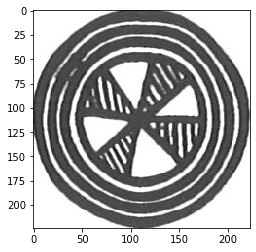

Labels correctos:
enclosing cross hatched concentric circle maltese 
Labels predichos:
enclosing ornament cross chevron metopal hatched small multiple concentric dotted quarter cruciform star quatrefoil circle outline reserved background arrangement chain tangential zigzag rosette floor point triple-line maltese twelve-leaved seven-leaved circular 


22 96e


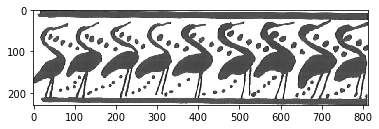

Labels correctos:
horizontal panel bird 
Labels predichos:
horizontal panel filling hatched double hook concentric dotted cross-hatched centre circle lozenge meander-like standing alternatively net zigzag scribble spiral tongue body bird 


23 44j


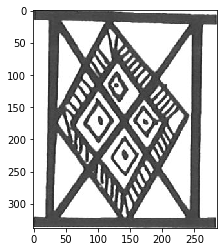

Labels correctos:
andrew's cross metopal hatched double dotted quarter outline lozenge underlying 
Labels predichos:
vertical andrew's cross pattern metopal diagonal hatched solid double multiple dotted quarter cross-hatched checkerboard metope star central quartered lozenge chain net underlying 


24 64a


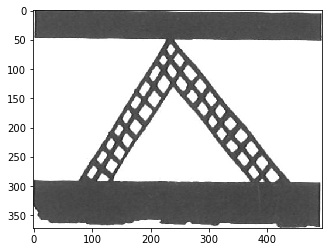

Labels correctos:
ornament chevron single cross-hatched shoulder 
Labels predichos:
horizontal panel group enclosing ornament oblique hatched triangle double triple concentric cross-hatched shoulder outline lozenge standing overlapping border 


25 44f


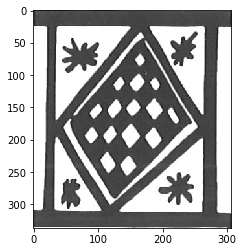

Labels correctos:
enclosing metopal double checkerboard hatching outline lozenge 
Labels predichos:
enclosing cross metopal diagonal hatched solid double dotted quarter cross-hatched checkerboard star hour-glass dot central circle outline quartered lozenge net underlying 


26 11k


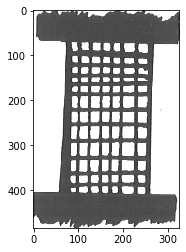

Labels correctos:
panel vertical rectangle cross-hatched 
Labels predichos:
horizontal panel vertical bar filling ornament hatched triangle double hook cross-hatched checkerboard simplified shoulder dot t-shaped outline lozenge gear-pattern chain side form zigzag scribble dash tongue 


27 49c


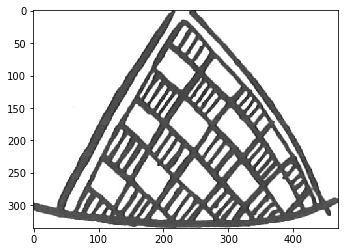

Labels correctos:
ornament triangle checkerboard hatching shoulder form 
Labels predichos:
horizontal panel enclosing ornament oblique hatched triangle cross-hatching double triple cross-hatched checkerboard shoulder dot outline lozenge form zigzag filled intertwinded 


28 36c


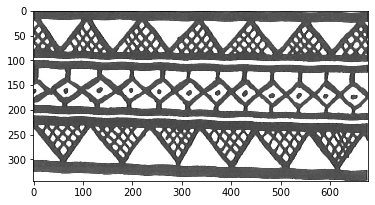

Labels correctos:
vertical bar apex lozenge 
Labels predichos:
horizontal panel vertical bar filling ornament pattern metopal oblique hatched triangle apex double multiple parallel dotted cross-hatched checkerboard centre cruciform hatching shoulder dot t-shaped outline lozenge chain row pointing outwards tapestry net. massed zigzag scribble tongue 


29 16d


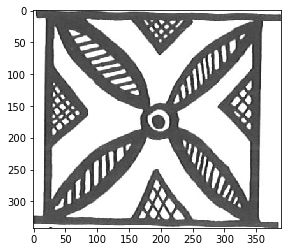

Labels correctos:
metopal hatched dotted quatrefoil central circle 
Labels predichos:
line andrew's cross metopal hatched double dotted cross-hatched doubled quatrefoil circle outline hexafoil 


30 28c


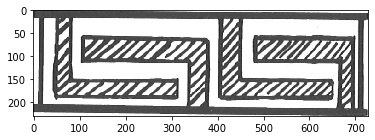

Labels correctos:
horizontal panel hatched hook meander 
Labels predichos:
horizontal panel line right hatched double multiple single hook circle battlement meander beam remaining space meander-like z-shaped standing scribble degeneration body bird 


31 3h


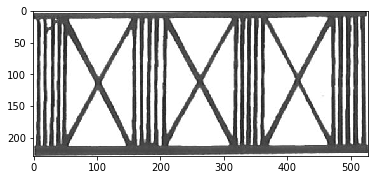

Labels correctos:
horizontal panel vertical bar alternating simple andrew's cross 
Labels predichos:
horizontal panel vertical bar andrew's cross inserted hatched triangle apex field double triple parallel cross-hatched checkerboard centre hatching checkerboarded dot outline lozenge checked chain spaced leaf form zigzag scribble 


32 16h


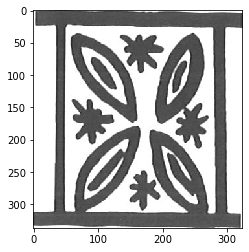

Labels correctos:
line simple metopal double single quatrefoil outline 
Labels predichos:
vertical andrew's metopal hatched double dotted cross-hatched quatrefoil central circle outline stalk tree rhodian confronted palm-tree 


33 48h


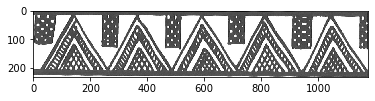

Labels correctos:
horizontal panel triangle triple cross-hatched outline 
Labels predichos:
horizontal panel vertical bar alternating andrew's cross chevron inserted hatched triangle apex field solid double triple half moon parallel dotted cross-hatched checkerboard checkerboarded dot outline lozenge chain leaf form zigzag scribble 


34 77a


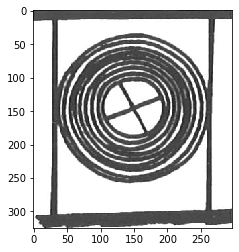

Labels correctos:
enclosing simple cross concentric george's circle 
Labels predichos:
enclosing filling ornament cross chevron metopal hatched small multiple concentric dotted quarter star circle outline reserved lozenge arrangement chain tangential zigzag rosette floor point maltese seven-leaved circular sunburst 


35 83f


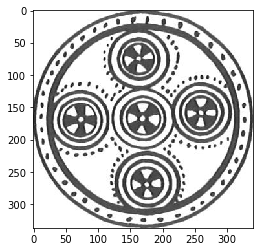

Labels correctos:
enclosing concentric cruciform circle 
Labels predichos:
enclosing ornament metopal hatched multiple concentric dotted cross-hatched cruciform star hatching dot quatrefoil circle outline reserved arrangement chain leaf tangential zigzag rosette flower floor point midrib v-shaped 


36 68d


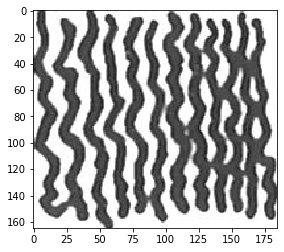

Labels correctos:
panel vertical scribble 
Labels predichos:
horizontal panel vertical bar filling pattern metopal hatched triangle apex large small field double triple multiple parallel dotted cross-hatched checkerboard centre hatching shoulder dot outline lozenge chain net row leaf tapestry net. zigzag scribble dash tongue 


37 36j


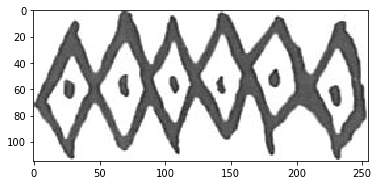

Labels correctos:
filling ornament dotted lozenge chain 
Labels predichos:
horizontal panel vertical metopal diagonal hatched triangle apex field solid double triple multiple parallel cross-hatched checkerboard checkerboarded outline lozenge chain net spaced leaf form zigzag scribble 


38 67e


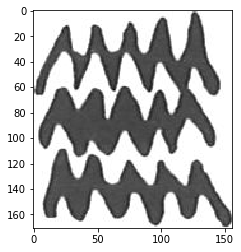

Labels correctos:
filling ornament multiple scribble 
Labels predichos:
horizontal panel filling ornament pattern metopal hatched triangle solid dotted quarter star circle lozenge checked chain leaf opposite direction windmill plant fish 


39 31f


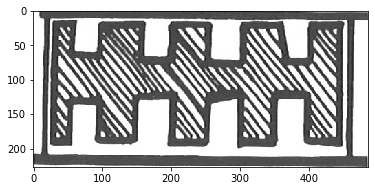

Labels correctos:
horizontal panel ornament hatched 
Labels predichos:
horizontal panel bar filling pattern hatched triangle wavy band double steep wave concentric dotted cross-hatched centre dot circle outline lozenge checked chain net row tapestry net. zigzag spiral 


40 40j


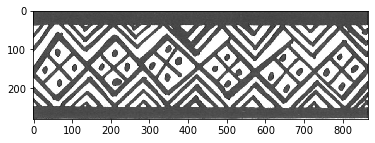

Labels correctos:
horizontal panel triangle stacked field dotted quartered lozenge chain 
Labels predichos:
horizontal panel vertical bar left hatched triangle apex field double parallel concentric dotted cross-hatched wolftooth dot circle outline lozenge chain two-tiered net row leaf three-tiered metopes cross-hathed zigzag ax dissimilar sigma turned four-limbed scribble 


41 93d


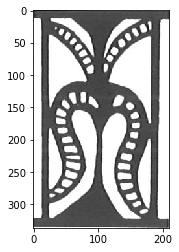

Labels correctos:
palm-tree 
Labels predichos:
vertical line metopal hatched double single cross-hatched quatrefoil circle outline stalk tree rhodian confronted palm-tree 


42 6b


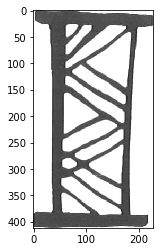

Labels correctos:
panel vertical opposed diagonal 
Labels predichos:
panel vertical pattern left stack hatched solid double dotted cross-hatched dot outline lozenge chain tangential superimposed column 


43 44l


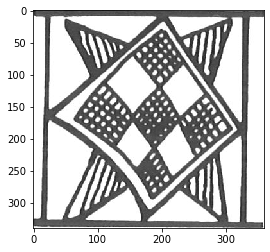

Labels correctos:
metopal star lozenge 
Labels predichos:
panel enclosing cross metopal diagonal hatched solid double dotted quarter cross-hatched checkerboard star hour-glass dot central circle outline quartered lozenge net 


44 92f


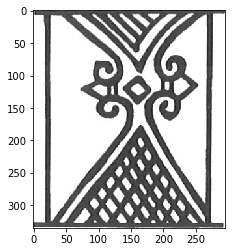

Labels correctos:
ornament metopal hatched cross-hatched hour-glass volute 
Labels predichos:
andrew's cross metopal hatched triangle double dotted cross-hatched hour-glass quatrefoil outline hexafoil tree rhodian confronted palm-tree 


45 28a


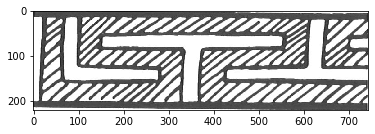

Labels correctos:
horizontal panel hatched t-meander 
Labels predichos:
horizontal panel line alternating pattern right left hatched double single hook parallel dotted cross-hatched circle battlement turning meander inverted enclosed intertwined wind swastika meander-like meander-type trident 


46 75c


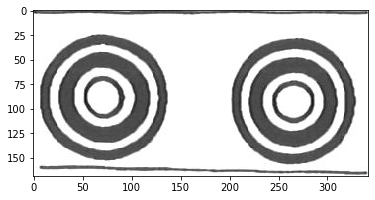

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel enclosing line hatched double multiple concentric circle swastika tangential tangent crossed cable 


47 38f


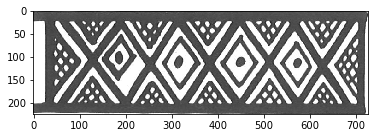

Labels correctos:
horizontal panel triangle field double dotted latticed lozenge chain 
Labels predichos:
horizontal panel vertical bar line filling ornament alternating andrew's chevron left opposed hatched triangle interlocked apex field double parallel dotted cross-hatched wolftooth dot outline lozenge checked chain row leaf metopes cross-hathed zigzag dissimilar sigma turned four-limbed scribble 


48 70d


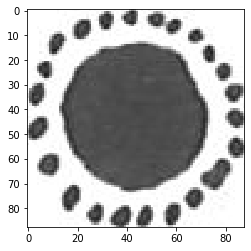

Labels correctos:
filling ornament dot rosette 
Labels predichos:
enclosing filling ornament cross hatched solid double hook dotted star dot circle outline lozenge checked swastika rosette fish 


49 8g


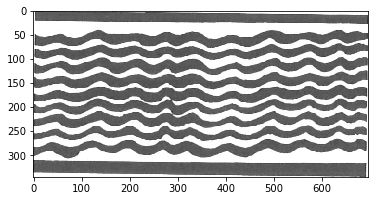

Labels correctos:
horizontal panel wavy band multiple 
Labels predichos:
panel vertical ornament stack hatched solid double multiple parallel dotted dot circle outline lozenge battlement arrangement frgt. chain meander-type row zigzag root stock scribble rectangular confronted tongue 


50 67h


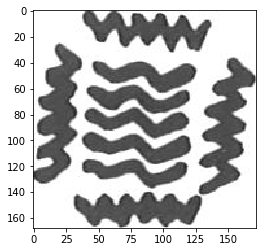

Labels correctos:
panel disposed scribble 
Labels predichos:
enclosing cross hatched dotted cross-hatched metope star dot circle lozenge chain tree tangential rosette flower point volute 


51 89b


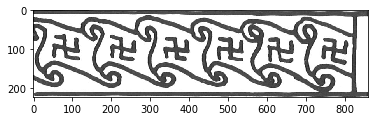

Labels correctos:
horizontal panel swastika net spiral 
Labels predichos:
horizontal panel vertical filling ornament pattern diagonal hatched triangle double multiple steep wave dotted cross-hatched checkerboard centre hatching dot lozenge chain net outwards tapestry net. zigzag scribble scale tongue 


52 48g


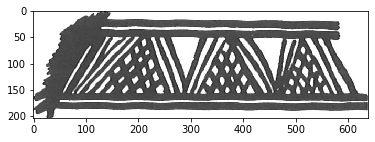

Labels correctos:
horizontal panel triangle triple cross-hatched outline 
Labels predichos:
horizontal panel bar line ornament alternating right left opposed hatched triangle double single hook cross-hatched battlement high meander chain facing turned 


53 57d


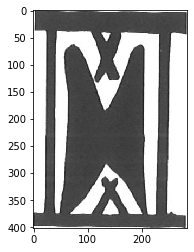

Labels correctos:
metopal solid double axe 
Labels predichos:
horizontal panel metopal triangle large solid wavy double multiple square eight-pointed star dot outline lozenge chain ax axe 


54 94e


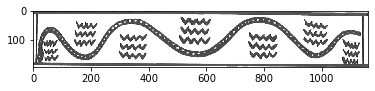

Labels correctos:
horizontal panel solid dot row serpent 
Labels predichos:
horizontal panel floating filling ornament hatched band double multiple steep wave cross-hatched circle lozenge space meander-like standing zigzag scribble cable spiral running body bird 


55 62e


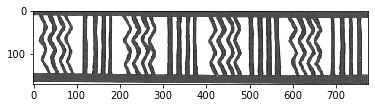

Labels correctos:
vertical parallel zigzag 
Labels predichos:
horizontal panel group vertical bar enclosing line filling ornament alternating simple chevron right left opposed diagonal hatched triangle solid disposed cross-hatched wolftooth star simplified dot row zigzag dissimilar sigma turned scribble 


56 43h


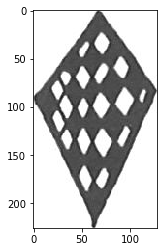

Labels correctos:
filling ornament lozenge checked 
Labels predichos:
enclosing filling ornament cross metopal hatched solid double hook dotted cross-hatched checkerboard star outline quartered lozenge checked detached outlined leaf fish 


57 55e


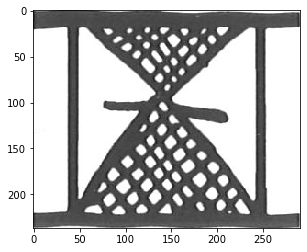

Labels correctos:
metopal cross-hatched hour-glass 
Labels predichos:
panel vertical andrew's cross metopal hatched triangle stacked solid double triple multiple dotted cross-hatched checkerboard hour-glass shoulder outline lozenge tree dash palm-tree 


58 90g


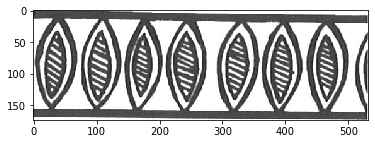

Labels correctos:
horizontal panel hatched double outline leaf 
Labels predichos:
horizontal panel vertical bar hatched triangle apex field solid double triple parallel dotted cross-hatched checkerboard checkerboarded dot outline lozenge chain two-tiered net leaf metopes side cross-hathed zigzag cut scribble 


59 74d


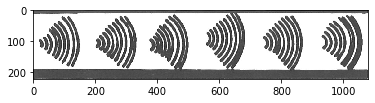

Labels correctos:
horizontal panel concentric 
Labels predichos:
horizontal panel vertical bar filling metopal hatched triangle solid double triple multiple hook pair parallel cross-hatched checkerboard hatching outline lozenge chain spaced leaf form zigzag scribble tongue 


60 11f


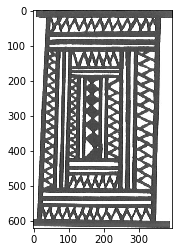

Labels correctos:
ornament rectangle set coffer 
Labels predichos:
horizontal panel vertical ornament metopal right left hatched apex stacked latticing double multiple single hook parallel rectangle set coffer dotted cross-hatched checkerboard hatching horizontally outline battlement link turning meander swastika hooked row zigzag 


61 91b


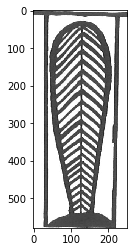

Labels correctos:
panel vertical filling tongue 
Labels predichos:
panel vertical bar filling metopal right left hatched triangle field solid double multiple dotted cross-hatched dot outline lozenge chain zigzag 


62 84i


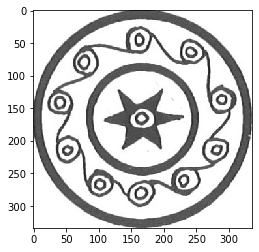

Labels correctos:
enclosing star circle chain tangential 
Labels predichos:
enclosing ornament metopal hatched multiple concentric dotted cross-hatched cruciform star dot quatrefoil circle outline arrangement chain leaf tangential zigzag rosette flower floor point maltese midrib seven-leaved volute 


63 49a


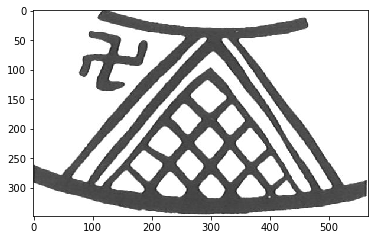

Labels correctos:
ornament triangle triple cross-hatched shoulder outline 
Labels predichos:
horizontal panel enclosing ornament hatched triangle cross-hatching double triple cross-hatched checkerboard shoulder dot outline lozenge form form-square filled intertwinded 


64 72g


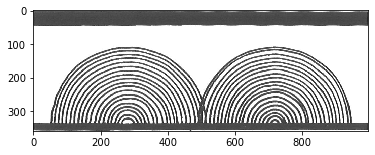

Labels correctos:
horizontal panel concentric standing semicircle 
Labels predichos:
horizontal panel enclosing ornament hatched double multiple concentric cross-hatched circle meander-like standing semicircle body bird 


65 51b


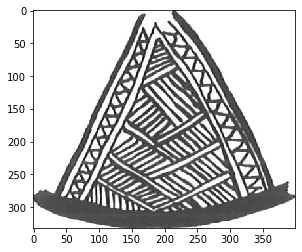

Labels correctos:
ornament composition triangle shoulder linear 
Labels predichos:
vertical enclosing ornament oblique hatched triangle cross-hatching double multiple cross-hatched checkerboard shoulder dot outline lozenge frgt. zigzag form-square filled intertwinded linear fringe ear corn 


66 49g


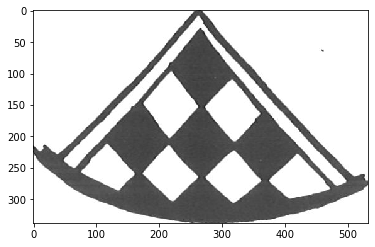

Labels correctos:
horizontal panel filling triangle large checkerboard 
Labels predichos:
horizontal enclosing filling ornament cross hatched triangle solid cross-hatching double hook cross-hatched checkerboard shoulder outline lozenge rectilinear outlined form-square filled 


67 91f


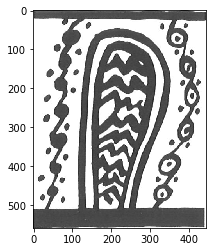

Labels correctos:
panel vertical filling tongue 
Labels predichos:
horizontal panel vertical filling ornament pattern metopal hatched solid multiple parallel dotted cross-hatched checkerboard cruciform shoulder dot outline lozenge rectilinear chain inverted meander-type outwards massed zigzag root stock tongue 


68 36k


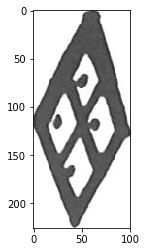

Labels correctos:
filling ornament dotted quartered lozenge 
Labels predichos:
enclosing filling ornament hatched double single hook dotted star dot circle outline quartered lozenge swastika schematized rosette spiked fish 


69 44d


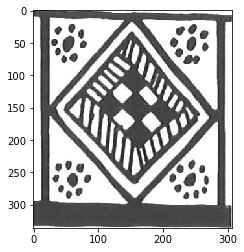

Labels correctos:
enclosing metopal double checkerboard hatching outline lozenge 
Labels predichos:
enclosing filling cross metopal hatched double dotted quarter cross-hatched checkerboard star dot quatrefoil central circle outline quartered lozenge arrangement chain zigzag rosette point seven-leaved 


70 41d


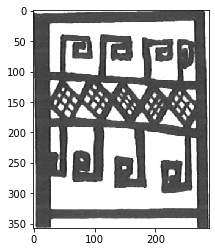

Labels correctos:
panel vertical hook cross-hatched lozenge rectilinear chain 
Labels predichos:
horizontal panel line filling ornament pattern metopal right left hatched solid multiple single hook cross-hatched checkerboard hatching rectilinear turning meander angle detached swastika 


71 50e


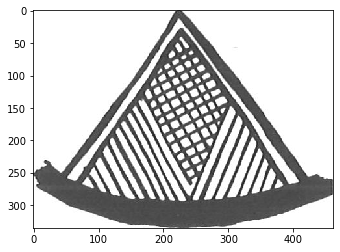

Labels correctos:
enclosing ornament triangle shoulder lozenge 
Labels predichos:
enclosing ornament composition hatched triangle cross-hatching double triple cross-hatched checkerboard shoulder dot outline lozenge form form-square filled intertwinded linear 


72 17h


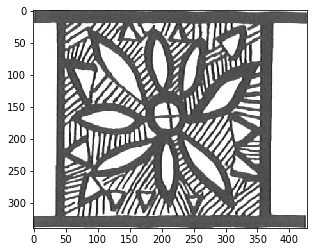

Labels correctos:
metopal hatched reserved background 
Labels predichos:
panel vertical pattern metopal hatched triangle apex stacked solid multiple parallel dotted cross-hatched latticed star spandrel outline lozenge chain tree rhodian tongue 


73 8f


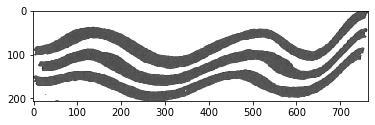

Labels correctos:
horizontal panel wavy band triple 
Labels predichos:
enclosing line filling ornament cross metopal diagonal hatched solid double dotted quarter cross-hatched star dot circle lozenge detached swastika tangential rosette 


74 35c


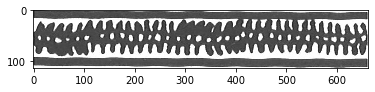

Labels correctos:
horizontal panel lozenge chain careless 
Labels predichos:
horizontal panel vertical bar floating line filling ornament right left opposed hatched double single metope lozenge battlement formed chain careless dogtooth ax facing three-limbed sigma turned four-limbed scribble degeneration 


75 25c


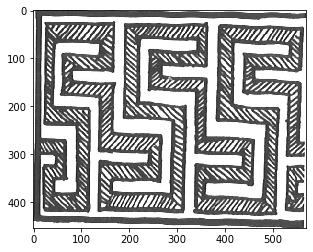

Labels correctos:
horizontal panel hatched triple meander 
Labels predichos:
horizontal panel ornament metopal right left hatched solid double multiple single hook parallel dotted outline battlement link rectilinear turning meander inverted swastika meander-type hooked 


76 71g


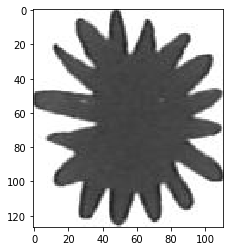

Labels correctos:
filling ornament star sixteen-pointed 
Labels predichos:
filling ornament pattern hatched solid band dotted eight-pointed star dot circle windmill rosette sixteen-pointed fish 


77 41c


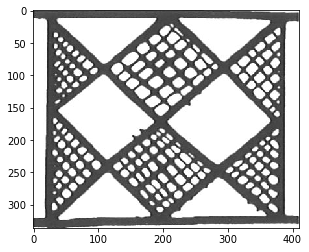

Labels correctos:
pattern metopal diagonal cross-hatched 
Labels predichos:
enclosing andrew's cross metopal diagonal hatched triangle double dotted cross-hatched checkerboard outline lozenge 


78 10b


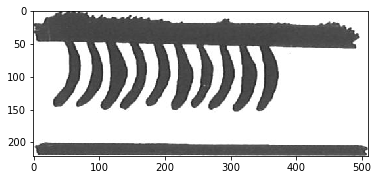

Labels correctos:
pendent horizontal panel half moon 
Labels predichos:
pendent horizontal panel vertical bar line filling ornament diagonal triangle solid double single concentric cross-hatched star lozenge pointing zigzag dogtooth massive 


79 24b


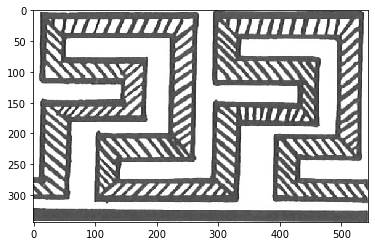

Labels correctos:
horizontal panel double meander 
Labels predichos:
horizontal panel ornament metopal right left hatched double multiple single hook parallel dotted hatching outline battlement link rectilinear attached turning meander chain inverted step swastika continuous repetition meander-type hooked 


80 82d


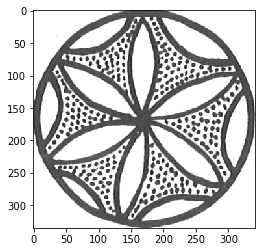

Labels correctos:
enclosing dotted circle reserved background hexafoil 
Labels predichos:
enclosing line ornament hatched double triple multiple dotted cross-hatched star hatching spandrel dot quatrefoil circle outline octofoil swastika leaf rosette floor eleven-pointed fan wing midrib 


81 77d


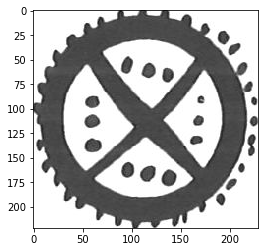

Labels correctos:
enclosing simple cross george's circle 
Labels predichos:
enclosing line filling ornament double single square dotted quarter star dot circle swastika tangential blob rosette spiked eight-armed floor four-spoked wheel 


82 58f


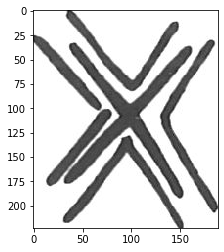

Labels correctos:
andrew's cross outlined 
Labels predichos:
line filling ornament andrew's cross metopal hatched double cross-hatched differently quatrefoil strong half-moon 


83 34c


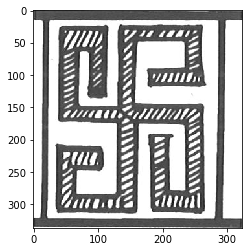

Labels correctos:
metopal right hatched turning swastika hooked 
Labels predichos:
panel vertical metopal right left hatched apex multiple single hook parallel rectangle dotted cross-hatched checkerboard outline battlement link turning meander inverted swastika tree hooked rhodian tongue 


84 36l


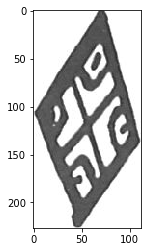

Labels correctos:
filling ornament dotted quartered lozenge 
Labels predichos:
enclosing filling ornament hatched double hook dotted cross-hatched star dot circle outline quartered lozenge outlined schematized rosette 


85 93h


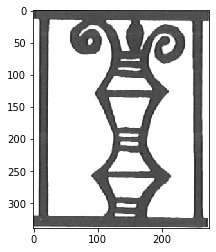

Labels correctos:
tree volute 
Labels predichos:
vertical cross composition hatched hook dotted cross-hatched metope eight-pointed star dot lozenge rectilinear chain tree outlined lozenge-cross rosette flower volute body bird 


86 25a


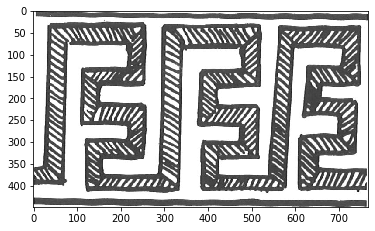

Labels correctos:
horizontal panel hatched double meander 
Labels predichos:
horizontal panel ornament pattern metopal right left hatched solid double multiple single hook parallel rectangle dotted cross-hatched outline battlement rectilinear attached turning meander angle inverted step swastika meander-type hooked 


87 57e


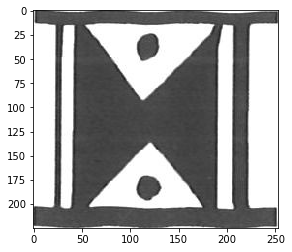

Labels correctos:
metopal solid double axe 
Labels predichos:
panel metopal hatched solid double dotted eight-pointed dot circle outline lozenge chain axe 


88 30b


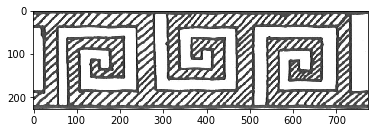

Labels correctos:
horizontal panel alternately hatched hook attached meander 
Labels predichos:
horizontal panel vertical bar line ornament alternating pattern right left hatched interlocked wavy band double hook parallel concentric dotted cross-hatched dot circle outline battlement checked interspaces turning meander chain inverted detached wind meander-like scribble 


89 74c


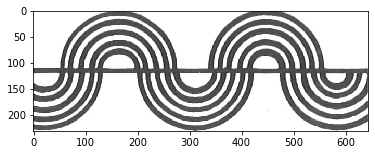

Labels correctos:
pendent horizontal panel alternately concentric standing semicircle 
Labels predichos:
horizontal panel bar enclosing hatched band double multiple steep wave concentric centre dot circle outline lozenge row cable 


90 20h


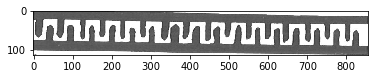

Labels correctos:
horizontal panel gear-pattern 
Labels predichos:
pendent horizontal panel vertical bar line filling ornament hatched triangle interlocked double single cross-hatched star lozenge chain careless row zigzag dogtooth massive 


91 44b


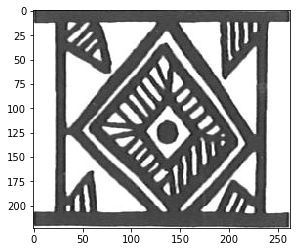

Labels correctos:
cross metopal hatched dot central lozenge 
Labels predichos:
horizontal panel enclosing cross metopal diagonal hatched triangle solid double triple dotted quarter cross-hatched checkerboard dot central outline quartered lozenge checked chain net underlying zigzag body bird long 


92 63e


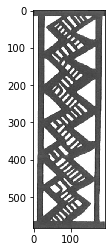

Labels correctos:
panel vertical hatched zigzag 
Labels predichos:
panel vertical right left hatched triangle stacked solid double multiple single dotted cross-hatched outline lozenge battlement link turning meander chain separate zigzag scribble 


93 89g


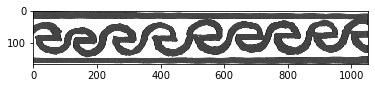

Labels correctos:
horizontal panel opposed chain 
Labels predichos:
pendent horizontal panel line left hatched wavy band double triple single hook dotted cross-hatched dot central circle lozenge meander chain separate row tangential blob zigzag sigma elongated 


94 41e


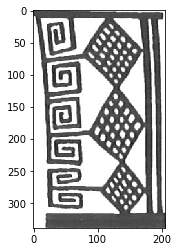

Labels correctos:
panel vertical hook cross-hatched lozenge rectilinear chain 
Labels predichos:
panel vertical metopal hatched triangle apex small stacked solid double multiple parallel rectangle dotted cross-hatched checkerboard star outline lozenge turning meander chain swastika tree hooked zigzag rhodian scribble tongue 


95 7c


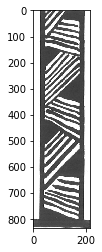

Labels correctos:
panel vertical opposed diagonal triangle separated solid 
Labels predichos:
horizontal panel vertical bar line filling ornament right left hatched triangle field solid double single concentric cross-hatched centre lozenge turning meander chain zigzag semicircle 


96 60f


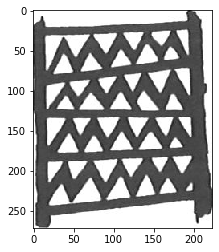

Labels correctos:
panel vertical line simple stacked zigzag 
Labels predichos:
horizontal panel vertical filling pattern metopal diagonal hatched solid double multiple parallel dotted cross-hatched checkerboard star lozenge checked chain detached net leaf zigzag confronted tongue plant 


97 27d


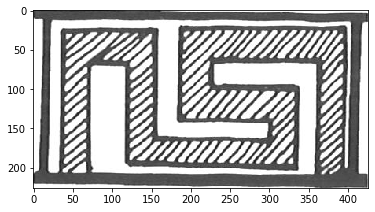

Labels correctos:
pattern hatched single pair battlement meander 
Labels predichos:
horizontal panel line pattern right left hatched double multiple single hook parallel dotted cross-hatched hatching outline battlement checked interspaces rectilinear turning meander chain inverted step detached wind swastika meander-like continuous repetition meander-type 


98 57f


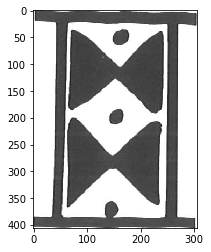

Labels correctos:
metopal solid double ax superimposed 
Labels predichos:
filling ornament small solid double single dotted eight-pointed star dot circle outline lozenge chain swastika axe rosette 


99 55f


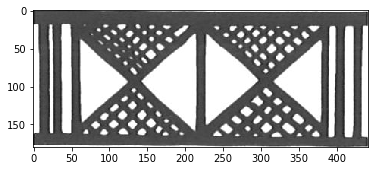

Labels correctos:
metopal cross-hatched 
Labels predichos:
horizontal panel vertical bar filling alternating andrew's cross inserted metopal hatched triangle apex field solid double hook parallel cross-hatched checkerboard outline checked swastika leaf zigzag scribble 


100 17g


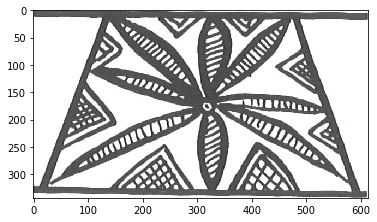

Labels correctos:
metopal hatched octofoil 
Labels predichos:
andrew's cross metopal hatched stacked double dotted cross-hatched latticed spandrel doubled quatrefoil circle outline reserved background hexafoil tree rhodian confronted 


101 47a


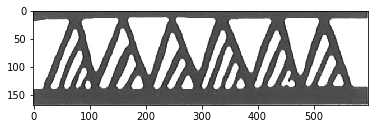

Labels correctos:
horizontal panel hatched triangle 
Labels predichos:
horizontal panel vertical bar hatched triangle apex field solid double triple half moon hook pair parallel cross-hatched checkerboard hatching simplified checkerboarded dot horizontally outline lozenge gear-pattern chain spaced leaf side version previous form zigzag ax scribble 


102 4c


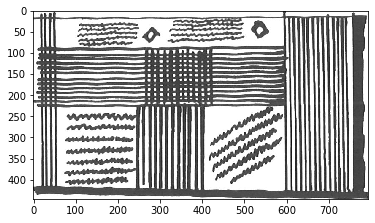

Labels correctos:
horizontal vertical bar composition 
Labels predichos:
horizontal panel line ornament metopal right left hatched solid double single hook concentric cross-hatched turning meander intertwined swastika meander-like hooked 


103 27a


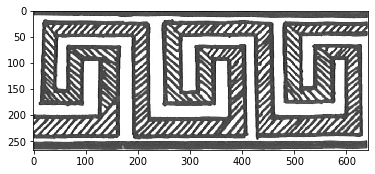

Labels correctos:
horizontal panel hatched meander 
Labels predichos:
horizontal panel bar ornament alternating pattern right left opposed hatched band double hook parallel dotted cross-hatched outline battlement checked interspaces rectilinear turning meander chain inverted detached wind meander-like 


104 90f


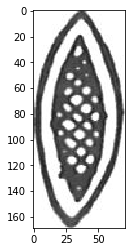

Labels correctos:
filling ornament double cross-hatched outline leaf 
Labels predichos:
enclosing filling ornament cross metopal hatched small double multiple concentric dotted cross-hatched checkerboard cruciform star quatrefoil circle outline quartered lozenge arrangement chain tangential zigzag rosette floor point triple-line circular sunburst 


105 25b


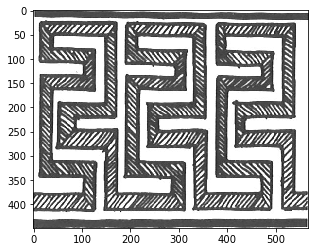

Labels correctos:
horizontal panel hatched triple meander 
Labels predichos:
horizontal panel ornament metopal right left hatched solid cross-hatching double multiple single hook parallel dotted cross-hatched hatching horizontally outline battlement link rectilinear turning meander inverted quadruple swastika meander-type hooked 


106 34f


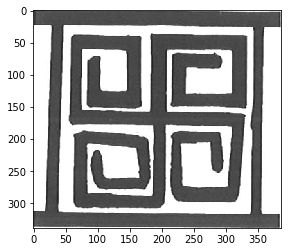

Labels correctos:
line metopal right single turning swastika hooked 
Labels predichos:
horizontal panel line ornament free design metopal right left hatched solid multiple single hook pair concentric cross-hatched checkerboard metope outline battlement link turning meander separate swastika 


107 65f


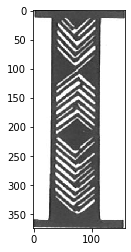

Labels correctos:
panel vertical filling chevron solid antithetic 
Labels predichos:
horizontal panel vertical bar line filling ornament pattern diagonally right left stack field solid double single cross-hatched centre lozenge battlement gear-pattern chain inverted careless zigzag superimposed fishbone semicircle 


108 47f


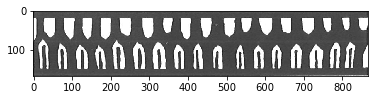

Labels correctos:
horizontal panel triangle simplified version previous 
Labels predichos:
horizontal panel vertical bar enclosing line filling ornament alternating solid double single dot careless pointing zigzag dogtooth accompanied antithetic ray ax 


109 76e


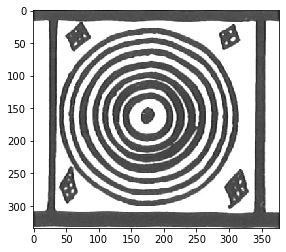

Labels correctos:
metopal concentric circle 
Labels predichos:
enclosing cross chevron metopal hatched small multiple concentric dotted quarter star quatrefoil circle outline reserved arrangement chain tangential zigzag rosette floor point semicircle maltese seven-leaved circular sunburst 


110 56b


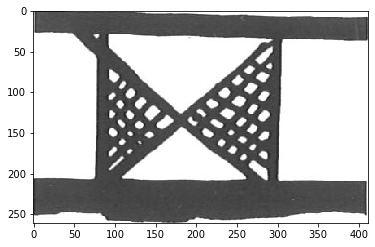

Labels correctos:
horizontal panel double cross-hatched axe 
Labels predichos:
horizontal panel group line ornament metopal oblique hatched triangle double concentric cross-hatched outline standing spaced overlapping shape intersecting axe scribble body 


111 76g


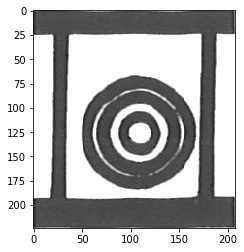

Labels correctos:
metopal concentric circle 
Labels predichos:
enclosing cross metopal small double concentric dotted quarter cross-hatched star hour-glass dot central circle swastika tangential blob rosette maltese four-spoked wheel sunburst 


112 29f


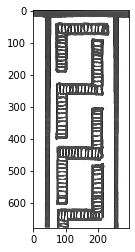

Labels correctos:
panel vertical hatched hook z-shaped 
Labels predichos:
panel vertical line filling metopal right left hatched triangle solid multiple single hook pair cross-hatched checkerboard dot outline lozenge battlement link turning meander chain swastika tree tongue 


113 66c


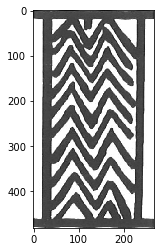

Labels correctos:
panel vertical stacked sigma 
Labels predichos:
vertical andrew's cross metopal hatched triangle stacked double dotted cross-hatched spandrel quatrefoil central circle outline lozenge tree outside rhodian confronted 


114 75i


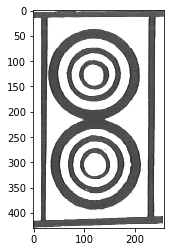

Labels correctos:
panel vertical concentric circle 
Labels predichos:
enclosing metopal hatched triple multiple dotted cross-hatched star dot central circle outline quartered lozenge chain tree tangential rosette flower volute 


115 63a


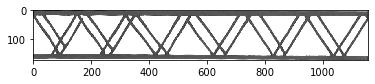

Labels correctos:
horizontal panel line double zigzag 
Labels predichos:
horizontal panel vertical bar simple left hatched triangle apex field solid double half moon hook parallel cross-hatched wolftooth simplified dot outline lozenge gear-pattern chain leaf metopes cross-hathed version previous zigzag ax cut sigma turned four-limbed scribble 


116 56e


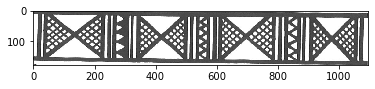

Labels correctos:
double cross-hatched separate metopes ax 
Labels predichos:
horizontal panel vertical bar alternating left hatched triangle apex field solid double half moon parallel cross-hatched wolftooth dot outline lozenge chain row leaf metopes cross-hathed version previous zigzag ax dissimilar cut sigma turned four-limbed scribble 


117 59d


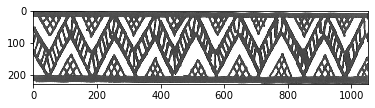

Labels correctos:
horizontal panel hatched wolftooth zigzag 
Labels predichos:
horizontal panel group vertical bar line filling ornament alternating simple chevron opposed diagonal hatched triangle solid obliquely disposed double half moon cross-hatched wolftooth star dot row zigzag dissimilar scribble 


118 95l


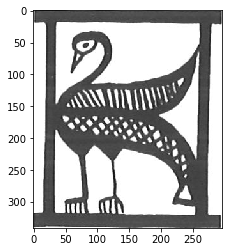

Labels correctos:
metopal hatched cross-hatched wing body bird raised 
Labels predichos:
andrew's cross composition metopal hatched solid double hook cross-hatched metope quatrefoil circle rectilinear lozenge-cross body bird head 


119 70j


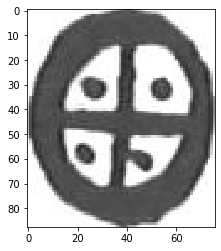

Labels correctos:
filling ornament quartered rosette 
Labels predichos:
enclosing line filling ornament cross small double hook dotted quarter star dot circle swastika blob rosette eight-armed floor four-spoked wheel 


120 46i


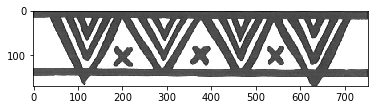

Labels correctos:
pendent horizontal panel triangle concentric 
Labels predichos:
pendent horizontal panel group vertical bar line filling ornament alternating opposed diagonal hatched triangle interlocked solid wavy double concentric cross-hatched wolftooth reserved lozenge row zigzag turned 


121 34b


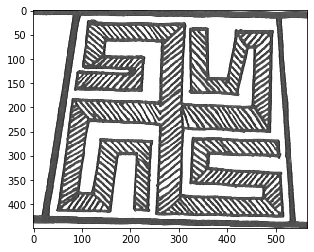

Labels correctos:
metopal left hatched turning swastika meander-like 
Labels predichos:
horizontal panel ornament metopal right left hatched solid double multiple single hook parallel dotted cross-hatched outline battlement link rectilinear turning meander inverted swastika meander-type hooked 


122 17d


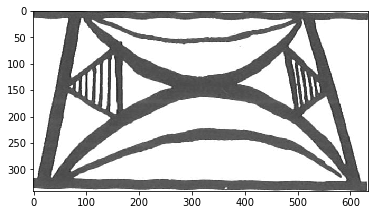

Labels correctos:
ornament metopal 
Labels predichos:
line andrew's cross metopal hatched double dotted cross-hatched hour-glass quatrefoil circle outline axe 


123 61g


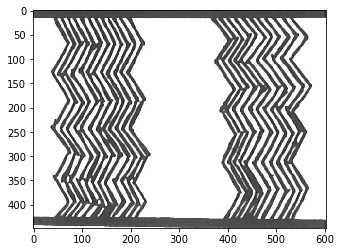

Labels correctos:
horizontal panel group vertical multiple parallel zigzag 
Labels predichos:
horizontal panel metopal hatched double concentric cross-hatched centre circle outline meander-like standing scribble semicircle spiral body bird 


124 76j


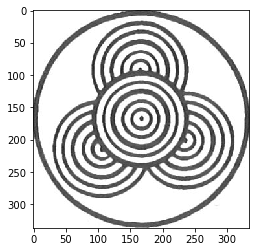

Labels correctos:
enclosing concentric circle overlapping 
Labels predichos:
horizontal enclosing ornament hatched multiple concentric dot quatrefoil circle outline chain leaf tangential zigzag rosette flower floor point maltese midrib 


125 86b


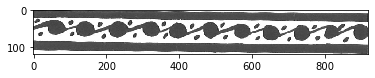

Labels correctos:
horizontal panel dot tangential blob flanking tangets 
Labels predichos:
horizontal panel line interlocked band double single hook dotted dot circle lozenge meander chain row tangential blob zigzag massive flanking elongated 


126 64g


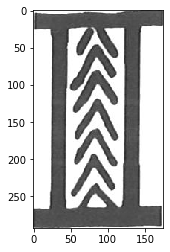

Labels correctos:
panel vertical stack inverted superimposed 
Labels predichos:
panel vertical metopal hatched triangle solid double dotted cross-hatched hour-glass dot outline lozenge chain 


127 38i


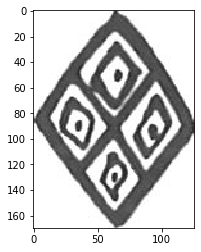

Labels correctos:
enclosing filling ornament small dotted lozenge 
Labels predichos:
enclosing filling ornament cross metopal hatched double dotted cross-hatched star quatrefoil circle outline quartered lozenge schematized rosette floor point 


128 3f


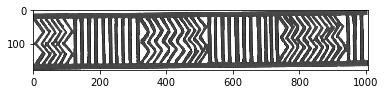

Labels correctos:
horizontal panel vertical bar filling ornament 
Labels predichos:
horizontal panel group vertical bar enclosing shorter line filling ornament alternating right opposed diagonal triangle separated solid cross-hatched checkerboard wolftooth simplified zigzag facing 


129 1e


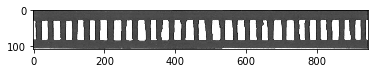

Labels correctos:
horizontal panel vertical bar 
Labels predichos:
horizontal panel vertical bar shorter line filling ornament opposed diagonal triangle interlocked separated solid single cross-hatched star careless zigzag dogtooth massive 


130 71j


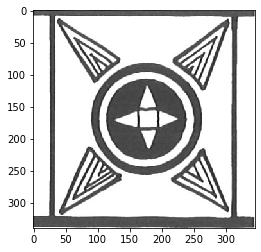

Labels correctos:
metopal triangle concentric star circle 
Labels predichos:
enclosing cross metopal hatched solid double concentric dotted cross-hatched star quatrefoil central circle outline lozenge tangential maltese 


131 96c


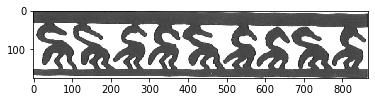

Labels correctos:
horizontal panel solid body bird 
Labels predichos:
pendent teardrop horizontal panel vertical bar line hatched triangle solid double single hook cross-hatched wolftooth dot outline lozenge chain zigzag ax massive turned 


132 27g


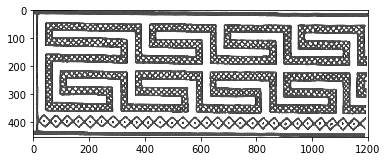

Labels correctos:
horizontal panel left hatched stacked turning meander 
Labels predichos:
horizontal panel ornament right left opposed hatched solid cross-hatching double multiple single hook parallel dotted outline battlement link turning meander inverted enclosed intertwined quadruple step swastika meander-like continuous repetition meander-type trident hooked 


133 13c


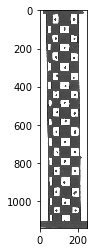

Labels correctos:
panel vertical dotted checkerboard 
Labels predichos:
panel vertical filling ornament metopal hatched triangle small stacked solid multiple parallel dotted cross-hatched checkerboard t-shaped outline lozenge battlement gear-pattern meander chain row zigzag rhodian root stock scribble tongue 


134 37i


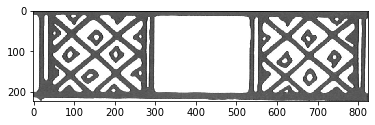

Labels correctos:
double lozenge separate net three-tiered metopes 
Labels predichos:
horizontal panel vertical hatched triangle double concentric dotted cross-hatched checkerboard centre hatching dot circle outline lozenge chain net leaf zigzag scribble spiral 


135 32b


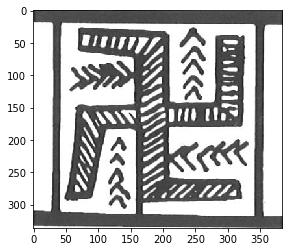

Labels correctos:
metopal hatched swastika 
Labels predichos:
horizontal panel pattern metopal right hatched apex double multiple single parallel rectangle set coffer dotted cross-hatched checkerboard outline battlement rectilinear turning meander chain inverted swastika tree hooked row massed zigzag rhodian root stock scribble tongue 


136 47d


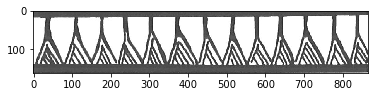

Labels correctos:
horizontal panel bar hatched triangle apex 
Labels predichos:
horizontal panel vertical bar line alternating simple left hatched triangle apex field solid double half moon parallel cross-hatched checkerboard wolftooth simplified dot outline lozenge chain leaf metopes cross-hathed version previous zigzag ax cut sigma scribble 


137 92d


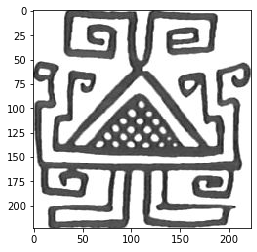

Labels correctos:
hook rectilinear figure 
Labels predichos:
ornament composition metopal hatched hook dotted metope circle rectilinear inverted confronted figure body bird 


138 24d


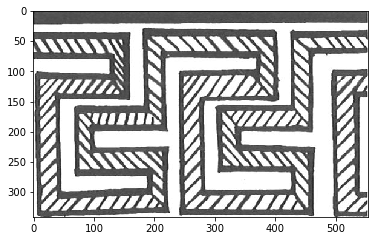

Labels correctos:
horizontal panel double meander inverted 
Labels predichos:
horizontal panel ornament pattern right left hatched cross-hatching double multiple single hook parallel dotted hatching outline battlement rectilinear turning meander chain inverted step meander-like meander-type 


139 96b


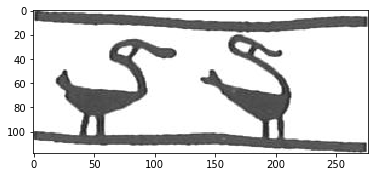

Labels correctos:
horizontal panel solid body bird 
Labels predichos:
horizontal panel filling ornament cross composition metopal hatched solid double hook concentric cross-hatched metope eight-pointed circle rectilinear lozenge-cross axe body bird 


140 20d


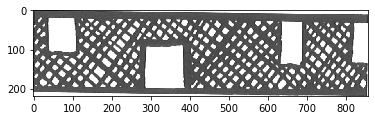

Labels correctos:
horizontal panel field cross-hatched gear-pattern 
Labels predichos:
horizontal panel group vertical bar line filling ornament alternating inserted left hatched triangle interlocked apex field double parallel cross-hatched checkerboard wolftooth dot outline checked chain row leaf zigzag dissimilar scribble 


141 48c


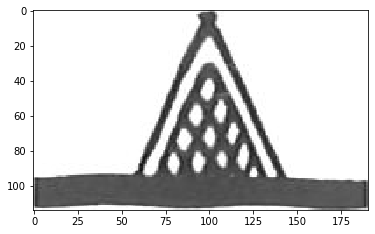

Labels correctos:
filling ornament triangle double cross-hatched outline 
Labels predichos:
enclosing filling ornament cross oblique hatched triangle cross-hatching double triple cross-hatched checkerboard shoulder outline lozenge form form-square filled intertwinded linear fringe ear corn 


142 21b


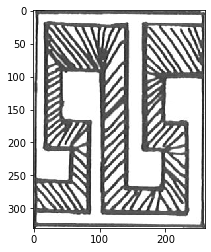

Labels correctos:
horizontal panel left hatched turning meander 
Labels predichos:
panel vertical ornament metopal hatched multiple parallel dotted cross-hatched outline lozenge rectilinear chain inverted tree rhodian 


143 12f


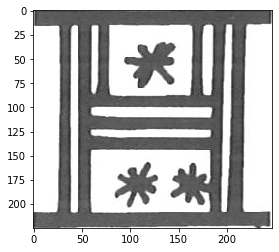

Labels correctos:
double-decker metope eight-pointed star 
Labels predichos:
panel vertical line metopal right left hatched triangle double multiple single hook pair cross-hatched checkerboard metope outline battlement link turning meander chain swastika tree scribble tongue body 


144 14g


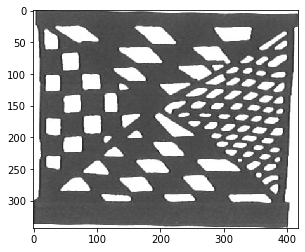

Labels correctos:
andrew's cross chevron metopal latticed checkerboarded 
Labels predichos:
horizontal panel vertical filling pattern metopal hatched triangle stacked solid multiple hook parallel cross-hatched checkerboard neck lozenge checked chain swastika net leaf opposite direction windmill tongue plant body bird 


145 21a


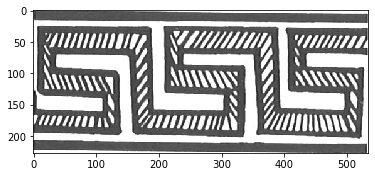

Labels correctos:
horizontal panel left hatched turning meander 
Labels predichos:
horizontal panel line alternating pattern right left opposed hatched double single hook battlement high slim turning meander enclosed detached wind meander-like z-shaped trident 


146 81g


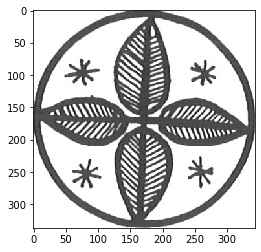

Labels correctos:
enclosing ornament hatching quatrefoil circle floor midrib 
Labels predichos:
enclosing ornament cross hatched multiple concentric dotted cross-hatched cruciform star hatching dot quatrefoil circle outline chain leaf rosette flower floor point midrib v-shaped 


147 44a


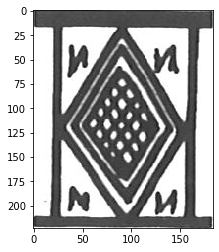

Labels correctos:
metopal triple cross-hatched centre outline lozenge 
Labels predichos:
horizontal panel enclosing cross metopal diagonal hatched triangle solid double dotted cross-hatched checkerboard metope neck central outline lozenge net body bird long 


148 36a


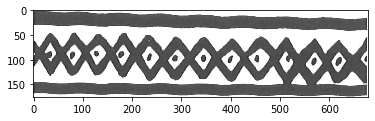

Labels correctos:
horizontal panel dotted lozenge chain 
Labels predichos:
horizontal panel line hatched band double triple single dotted cross-hatched dot central circle lozenge chain separate row tangential blob zigzag flanking tangent tagential elongated 


149 54a


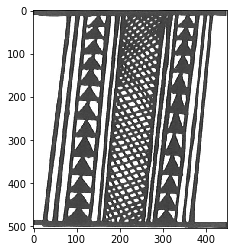

Labels correctos:
panel vertical triangle stacked solid 
Labels predichos:
horizontal panel vertical bar filling ornament metopal hatched triangle apex small field double multiple hook parallel cross-hatched checkerboard cruciform latticed hatching simplified shoulder dot outline meander swastika zigzag scribble tongue 


150 31g


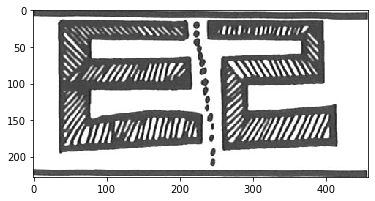

Labels correctos:
horizontal ornament 
Labels predichos:
horizontal panel pattern metopal right left opposed hatched solid double single hook metope battlement link turning meander inverted intertwined swastika meander-like z-shaped meander-type trident body bird 


151 85c


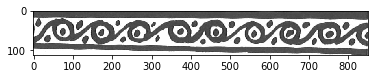

Labels correctos:
horizontal panel dotted dot circle flanking tangent tagential 
Labels predichos:
horizontal panel line left hatched band double single hook dotted cross-hatched dot circle lozenge chain separate row tangential blob zigzag sigma turned four-limbed elongated 


152 92b


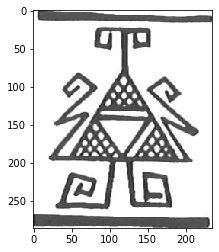

Labels correctos:
hook rectilinear figure 
Labels predichos:
ornament composition hatched hook cross-hatched metope shoulder rectilinear inverted lozenge-cross superimposed fringe ear corn confronted figure body bird 


153 71a


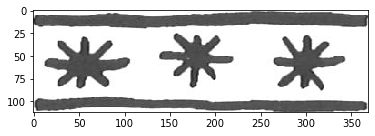

Labels correctos:
horizontal panel eight-pointed star 
Labels predichos:
pendent horizontal panel line filling ornament opposed hatched small wavy band double single hook cross-hatched metope eight-pointed dot circle swastika row pointing tangential upwards inner looped 


154 81j


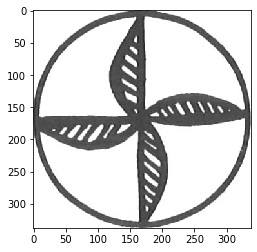

Labels correctos:
enclosing ornament hatched circle windmill floor 
Labels predichos:
enclosing ornament cross hatched double cross-hatched cruciform star hatching dot quatrefoil circle outline hexafoil swastika leaf rosette flower floor point triple-line midrib v-shaped 


155 75h


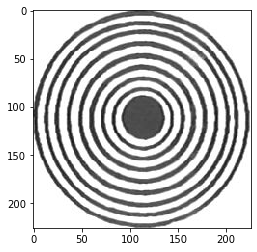

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
enclosing ornament cross chevron metopal hatched small multiple concentric dotted quarter quatrefoil circle outline reserved background arrangement chain tangential zigzag rosette floor point maltese seven-leaved circular 


156 73a


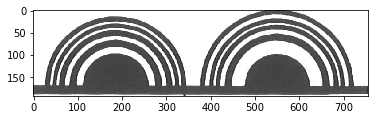

Labels correctos:
horizontal panel solid concentric centre standing semicircle 
Labels predichos:
horizontal panel vertical bar enclosing filling metopal hatched solid multiple concentric cross-hatched checkerboard centre hour-glass neck circle outline lozenge standing form zigzag semicircle three-quarter tongue body bird long 


157 81d


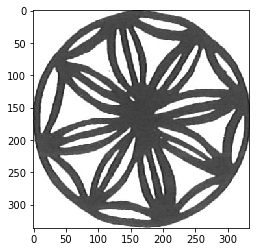

Labels correctos:
enclosing ornament circle octofoil floor midrib 
Labels predichos:
enclosing line ornament hatched double triple dotted cross-hatched star hatching dot quatrefoil circle outline background octofoil swastika leaf rosette floor eleven-pointed fan wing midrib 


158 57k


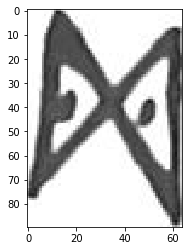

Labels correctos:
filling ornament double axe 
Labels predichos:
line filling ornament hatched double single square star saltire dot quatrefoil outline strong swastika axe 


159 7d


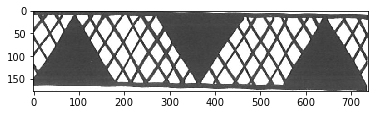

Labels correctos:
horizontal panel opposed triangle solid cross-hatching 
Labels predichos:
horizontal panel vertical bar line filling ornament alternating opposed hatched triangle field solid double half concentric cross-hatched wolftooth shoulder outline reserved zigzag 


160 45a


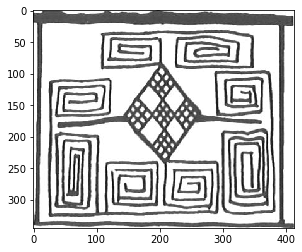

Labels correctos:
hook rectilinear lozenge-cross 
Labels predichos:
horizontal panel ornament metopal right left hatched solid cross-hatching double multiple single hook parallel dotted outline battlement link rectilinear turning meander inverted intertwined swastika meander-like meander-type hooked 


161 21d


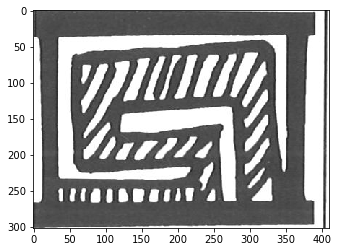

Labels correctos:
left hatched single link turning meander 
Labels predichos:
horizontal panel group vertical line right left hatched double single hook cross-hatched outline battlement link formed turning meander separate meander-like standing alternatively sigma turned four-limbed scribble degeneration 


162 39f


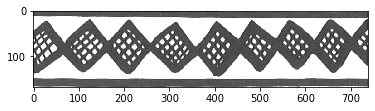

Labels correctos:
horizontal panel cross-hatched lozenge chain 
Labels predichos:
horizontal panel floating left hatched band double triple steep wave single hook dotted cross-hatched horizontally central circle outline lozenge chain separate alternatively two-tiered net row leaf tangential zigzag sigma turned four-limbed scribble 


163 29a


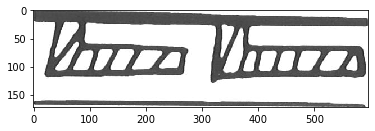

Labels correctos:
horizontal panel hatched hook 
Labels predichos:
pendent horizontal panel group floating line filling ornament simple chevron inclined oblique opposed hatched triangle small band double single hook cross-hatched metope eight-pointed circle swastika row spaced upwards axe inner looped 


164 32d


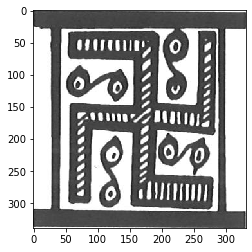

Labels correctos:
metopal hatched swastika 
Labels predichos:
panel vertical metopal right left hatched apex stacked multiple single hook parallel rectangle dotted cross-hatched checkerboard link turning meander inverted swastika tree hooked rhodian tongue 


165 47i


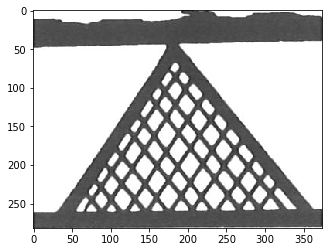

Labels correctos:
horizontal panel triangle cross-hatched 
Labels predichos:
horizontal panel enclosing ornament oblique hatched triangle double triple concentric cross-hatched checkerboard shoulder dot outline lozenge form zigzag border intertwinded 


166 80d


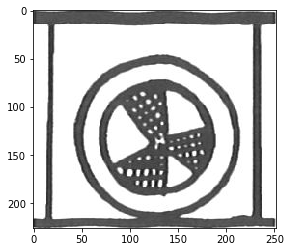

Labels correctos:
enclosing metopal concentric cross-hatched circle fan 
Labels predichos:
enclosing cross metopal hatched small multiple concentric cross-hatched checkerboard star hour-glass dot central circle lozenge swastika tangential zigzag rosette point maltese seven-leaved sunburst 


167 75k


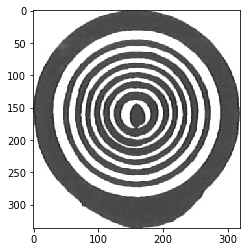

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
enclosing ornament cross chevron metopal hatched small multiple concentric dotted quarter star quatrefoil circle outline reserved arrangement chain tangential zigzag rosette floor point triple-line maltese seven-leaved circular 


168 80a


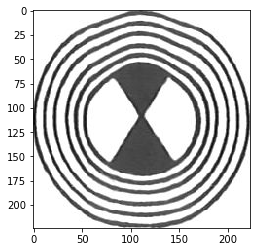

Labels correctos:
enclosing solid concentric hour-glass circle 
Labels predichos:
enclosing ornament cross chevron metopal hatched small multiple concentric dotted quarter quatrefoil circle outline reserved background arrangement chain tangential zigzag rosette floor point maltese seven-leaved circular 


169 78c


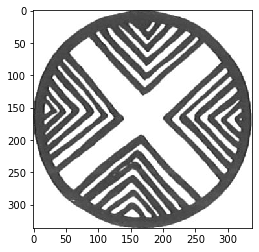

Labels correctos:
enclosing ornament cross chevron circle reserved floor 
Labels predichos:
enclosing line filling ornament cross hatched double dotted cross-hatched spandrel differently dot quatrefoil circle outline strong surrounded swastika floor fan 


170 82e


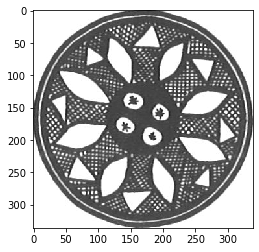

Labels correctos:
enclosing cross-hatched circle reserved background octofoil 
Labels predichos:
enclosing line alternately ornament cross pattern hatched solid double dotted quarter cross-hatched cruciform star circle reserved chain swastika leaf rosette eight-armed floor point eleven-pointed branch midrib four-spoked wheel 


171 43d


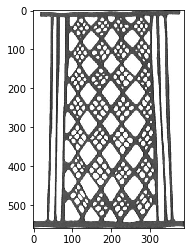

Labels correctos:
panel vertical diagonal cross-hatched checkerboard lozenge net massed 
Labels predichos:
horizontal panel vertical bar filling pattern metopal hatched triangle apex large small stacked double multiple parallel dotted cross-hatched checkerboard cruciform latticed star shoulder dot t-shaped lozenge chain row side zigzag scribble dash tongue 


172 74b


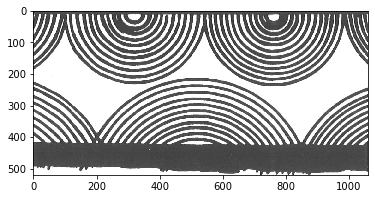

Labels correctos:
pendent concentric standing opposite semicircle 
Labels predichos:
horizontal panel filling ornament chevron stack hatched cross-hatched spandrel dot circle lozenge inverted superimposed fishbone wing figure serpent body bird 


173 61d


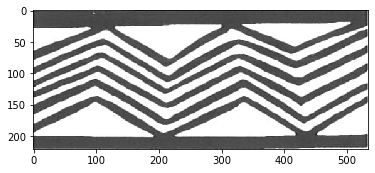

Labels correctos:
horizontal panel multiple parallel angle zigzag 
Labels predichos:
horizontal panel enclosing simple cross metopal hatched solid double concentric cross-hatched dot quatrefoil central circle outline tangential maltese 


174 87f


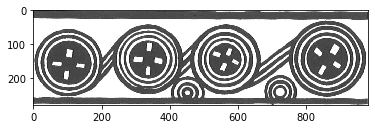

Labels correctos:
horizontal panel enclosing cross triple circle reserved tangential 
Labels predichos:
horizontal panel enclosing line filling ornament hatched band double multiple steep wave concentric dot circle lozenge meander-like tangential zigzag tangent crossed cable doted spiral running 


175 40h


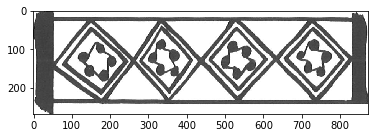

Labels correctos:
horizontal panel enclosing double circle outline lozenge chain tangential blob 
Labels predichos:
horizontal panel filling ornament pattern diagonal hatched triangle band double multiple steep wave concentric dotted cross-hatched checkerboard centre hatching dot circle outline lozenge chain net row leaf tapestry net. zigzag scribble spiral 


176 9d


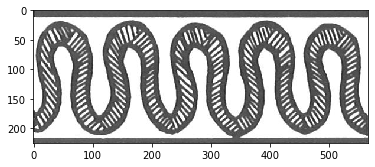

Labels correctos:
horizontal panel hatched band steep wave 
Labels predichos:
horizontal panel filling ornament pattern diagonal hatched band double multiple steep wave concentric dotted cross-hatched centre dot circle lozenge chain standing net zigzag scale spiral 


177 45d


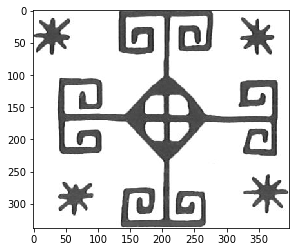

Labels correctos:
hook rectilinear lozenge-cross 
Labels predichos:
filling ornament cross composition metopal hatched hook cross-hatched metope eight-pointed circle rectilinear lozenge-cross body bird 


178 39i


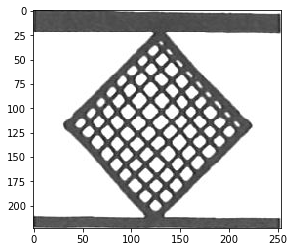

Labels correctos:
filling ornament cross-hatched lozenge 
Labels predichos:
enclosing filling ornament hatched triangle cross-hatching double hook cross-hatched checkerboard shoulder dot outline lozenge form form-square filled intertwinded 


179 44e


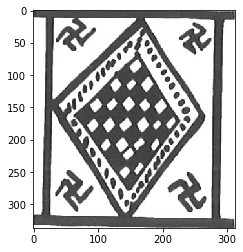

Labels correctos:
enclosing metopal double checkerboard hatching outline lozenge 
Labels predichos:
enclosing filling ornament cross metopal hatched double dotted cross-hatched checkerboard star dot central outline quartered lozenge zigzag 


180 17f


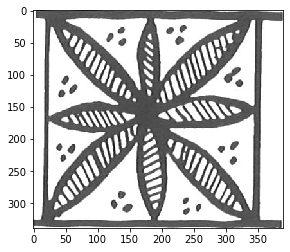

Labels correctos:
metopal hatched octofoil 
Labels predichos:
andrew's cross metopal hatched stacked double multiple dotted cross-hatched spandrel quatrefoil central circle outline stalk quartered hexafoil tree confronted palm-tree 


181 36g


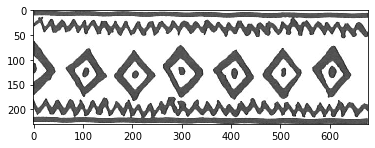

Labels correctos:
horizontal panel dotted lozenge spaced 
Labels predichos:
horizontal panel vertical bar filling ornament alternating pattern right left hatched wavy band double hook concentric cross-hatched centre circle outline battlement checked turning meander chain inverted detached wind swastika meander-like standing 


182 35e


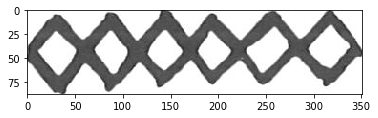

Labels correctos:
horizontal filling ornament lozenge chain 
Labels predichos:
horizontal panel vertical metopal hatched triangle solid double triple multiple parallel cross-hatched checkerboard outline lozenge chain spaced leaf plant 


183 36i


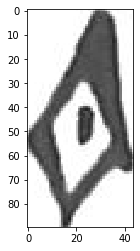

Labels correctos:
filling ornament dotted lozenge 
Labels predichos:
filling ornament double single dotted star dot circle outline lozenge swastika blob schematized rosette spiked fish 


184 35g


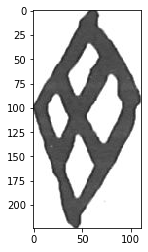

Labels correctos:
filling ornament quartered lozenge 
Labels predichos:
enclosing filling ornament hatched double single dotted star dot circle outline lozenge checked swastika schematized rosette fish 


185 23a


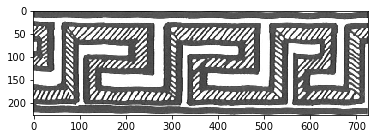

Labels correctos:
horizontal panel right hatched turning meander 
Labels predichos:
horizontal panel line alternating pattern right left opposed hatched band double single hook dotted cross-hatched battlement checked turning meander chain detached wind meander-like standing trident 


186 18e


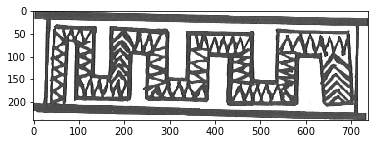

Labels correctos:
horizontal panel battlement 
Labels predichos:
horizontal panel floating line right left hatched band double single hook dotted cross-hatched outline battlement turning meander chain meander-like z-shaped standing net row four-tiered scribble 


187 16f


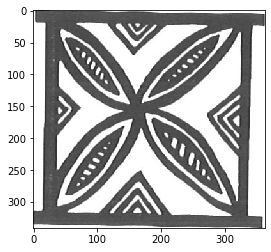

Labels correctos:
metopal hatched double quatrefoil outline 
Labels predichos:
andrew's cross chevron metopal hatched stacked double dotted cross-hatched latticed hour-glass spandrel quatrefoil circle 


188 70i


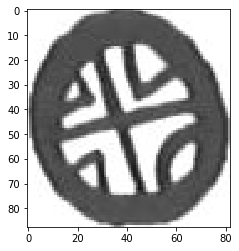

Labels correctos:
filling ornament quartered rosette 
Labels predichos:
enclosing line filling ornament cross single square dotted quarter star shoulder dot circle swastika rosette eight-armed floor four-spoked wheel 


189 79e


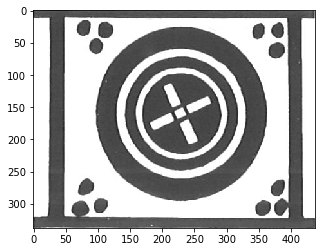

Labels correctos:
enclosing cross concentric circle reserved 
Labels predichos:
enclosing filling ornament cross metopal hatched small double concentric dotted quarter cross-hatched star central circle outline reserved quartered lozenge arrangement chain tangential zigzag rosette point maltese seven-leaved circular sunburst 


190 19g


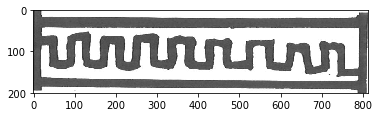

Labels correctos:
horizontal panel line single battlement 
Labels predichos:
horizontal panel line filling ornament hatched wavy band double multiple single hook dotted dot circle meander separate row tangential blob zigzag 


191 28j


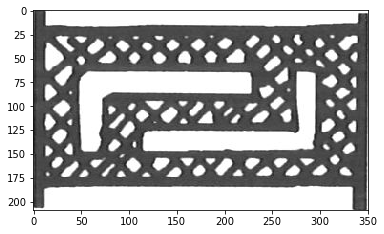

Labels correctos:
single hook pair cross-hatched reserved background meander 
Labels predichos:
horizontal panel line pattern metopal right left hatched double multiple single hook parallel rectangle set coffer dotted cross-hatched hatching outline battlement link rectilinear attached turning meander angle inverted step detached swastika t-meander meander-like hooked 


192 82j


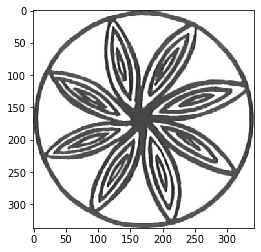

Labels correctos:
enclosing ornament triple circle outline octofoil floor 
Labels predichos:
enclosing line ornament hatched double triple multiple dotted cross-hatched star hatching dot quatrefoil circle outline hexafoil octofoil swastika leaf rosette floor eleven-pointed fan wing midrib 


193 28g


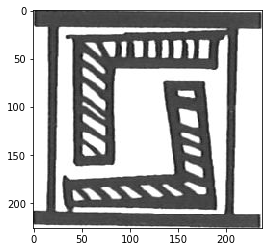

Labels correctos:
metopal hatched single hook pair meander 
Labels predichos:
panel vertical metopal right left hatched triangle double multiple single hook pair rectangle cross-hatched outline battlement link turning meander swastika tree 


194 75g


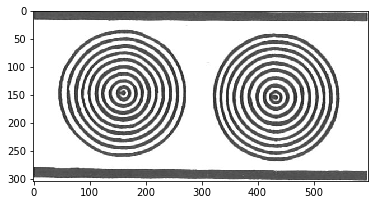

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel enclosing hatched solid double multiple concentric george's dot quatrefoil circle tangential crossed cable 


195 76b


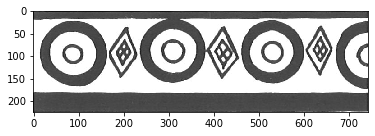

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
pendent horizontal panel line filling ornament hatched wavy band double steep wave single hook concentric cross-hatched circle reserved lozenge meander detached swastika meander-like standing alternatively triple-outline sigma scribble spiral 


196 67g


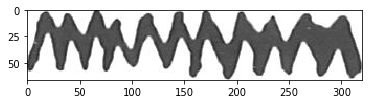

Labels correctos:
filling ornament scribble 
Labels predichos:
horizontal panel vertical bar alternating triangle solid double multiple pair cross-hatched shoulder dot outline lozenge chain leaf accompanied antithetic ray ax windmill column 


197 46j


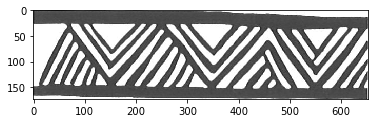

Labels correctos:
pendent horizontal panel triangle concentric hatching 
Labels predichos:
horizontal panel vertical bar line alternating diagonally right left diagonal hatched triangle solid double single cross-hatched wolftooth star dot lozenge chain row zigzag ax sigma turned four-limbed scribble 


198 91h


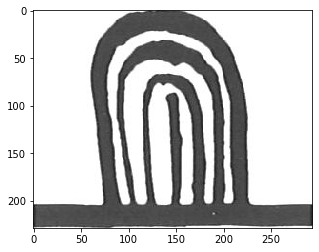

Labels correctos:
line filling ornament multiple tongue 
Labels predichos:
horizontal panel vertical bar enclosing filling ornament hatched triangle cross-hatched checkerboard shoulder t-shaped lozenge form intertwinded 


199 47c


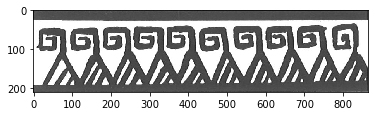

Labels correctos:
horizontal panel hatched triangle apex hook rectilinear 
Labels predichos:
horizontal panel group floating line hatched double dotted cross-hatched circle lozenge meander-like standing alternatively two-tiered net three-tiered four-tiered sigma scribble spiral 


200 76d


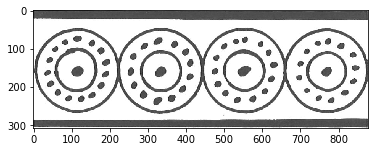

Labels correctos:
horizontal panel double dot circle chain enclosed 
Labels predichos:
horizontal panel enclosing line ornament hatched small band double multiple steep wave concentric dot circle meander-like tangential crossed cable doted running 


201 62f


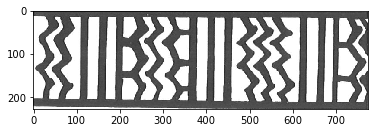

Labels correctos:
bar apex parallel zigzag 
Labels predichos:
horizontal panel vertical bar alternating andrew's cross chevron inserted left hatched triangle apex field double half moon parallel dotted cross-hatched checkerboard wolftooth dot outline lozenge checked chain row leaf metopes cross-hathed zigzag dissimilar cut four-limbed scribble 


202 72a


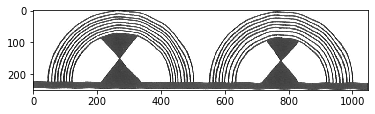

Labels correctos:
horizontal panel concentric centre hour-glass standing semicircle 
Labels predichos:
horizontal panel vertical bar enclosing filling pattern metopal hatched solid multiple concentric cross-hatched checkerboard centre hour-glass neck circle lozenge standing zigzag semicircle three-quarter tongue body bird long 


203 61a


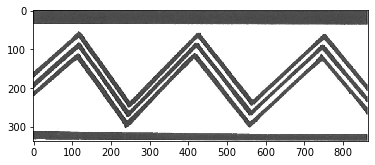

Labels correctos:
horizontal panel large triple parallel zigzag 
Labels predichos:
horizontal panel floating enclosing line filling ornament metopal oblique hatched triangle small double concentric cross-hatched circle lozenge meander-like standing spaced zigzag border axe sigma scribble spiral running body 


204 80g


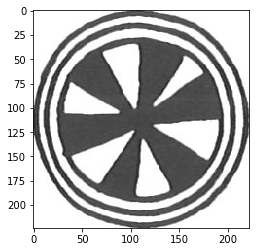

Labels correctos:
solid fan wing 
Labels predichos:
enclosing line ornament cross hatched solid double concentric dotted quarter cruciform star dot quatrefoil circle outline reserved background swastika rosette floor point eleven-pointed wheel 


205 32c


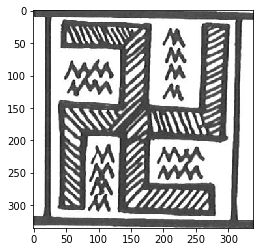

Labels correctos:
metopal hatched swastika 
Labels predichos:
panel vertical metopal hatched triangle apex small stacked double multiple parallel rectangle set coffer dotted cross-hatched checkerboard latticed outline lozenge rectilinear turning meander chain inverted swastika tree hooked row zigzag rhodian root stock scribble tongue 


206 40i


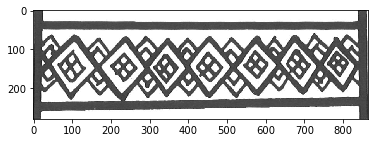

Labels correctos:
horizontal panel chevron double centre quartered lozenge chain 
Labels predichos:
horizontal panel floating left hatched band double single hook dotted cross-hatched dot circle lozenge battlement chain two-tiered net row slack leaf three-tiered four-tiered zigzag sigma turned four-limbed scribble 


207 81e


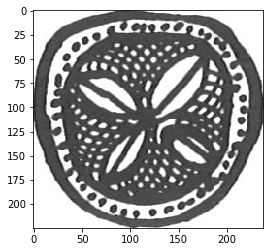

Labels correctos:
enclosing cross-hatched quatrefoil circle reserved background midrib 
Labels predichos:
enclosing line ornament cross pattern metopal hatched solid double triple dotted cross-hatched cruciform star hatching spandrel dot quatrefoil circle outline reserved background octofoil chain leaf rosette floor point eleven-pointed wing midrib twelve-leaved 


208 70q


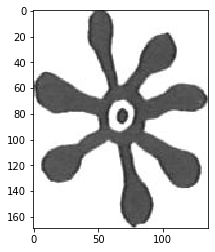

Labels correctos:
filling ornament solid rosette 
Labels predichos:
line filling ornament cross pattern hatched dotted eight-pointed star dot circle strong swastika outlined leaf windmill rosette sixteen-pointed 


209 82a


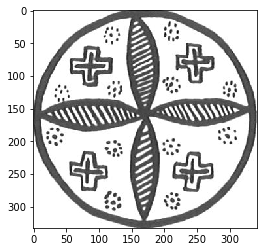

Labels correctos:
enclosing ornament hatched quatrefoil circle floor 
Labels predichos:
enclosing ornament hatched double triple multiple dotted cross-hatched hatching dot quatrefoil circle outline octofoil chain leaf rosette flower floor point midrib 


210 59g


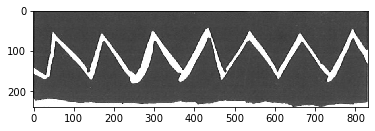

Labels correctos:
horizontal panel zigzag 
Labels predichos:
horizontal panel line filling ornament triangle solid wavy band double single rectangle concentric cross-bar cross-hatched star shoulder dot reserved chain pointing zigzag dogtooth downwards massive 


211 95c


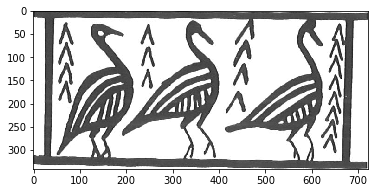

Labels correctos:
horizontal panel hatched body bird 
Labels predichos:
horizontal panel andrew's cross metopal hatched triangle solid double triple multiple dotted cross-hatched checkerboard circle lozenge checked chain net spaced leaf zigzag tongue body bird long 


212 70k


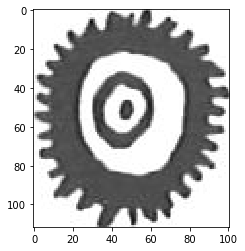

Labels correctos:
filling ornament rosette spiked 
Labels predichos:
filling ornament small wavy double single rectangle concentric dotted quarter eight-pointed star dot circle chain swastika tangential blob rosette spiked floor four-spoked wheel 


213 87b


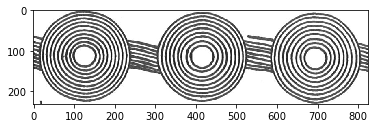

Labels correctos:
horizontal panel multiple circle tangent 
Labels predichos:
horizontal panel enclosing line hatched solid double multiple single concentric dot quatrefoil circle outline meander-like cable 


214 21e


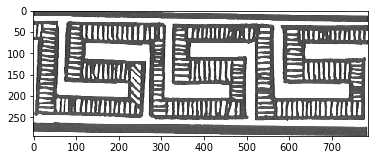

Labels correctos:
horizontal panel right left hatched turning meander angle 
Labels predichos:
horizontal panel ornament pattern right left opposed hatched solid cross-hatching double single hook parallel battlement turning meander inverted enclosed intertwined step swastika meander-like continuous repetition meander-type trident 


215 61f


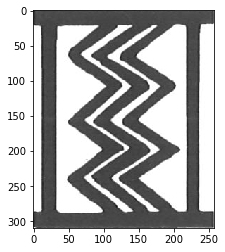

Labels correctos:
panel vertical triple parallel zigzag 
Labels predichos:
panel vertical pattern hatched triple dotted cross-hatched metope eight-pointed star dot circle outline lozenge chain rosette volute body 


216 12b


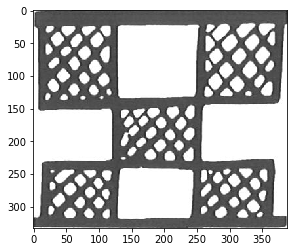

Labels correctos:
metopal checkerboard cruciform latticed 
Labels predichos:
horizontal panel vertical metopal hatched triangle double cross-hatched checkerboard centre hatching shoulder circle outline form scribble three-quarter tongue 


217 16g


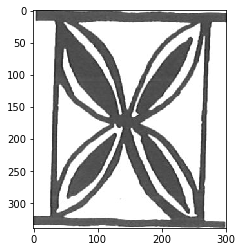

Labels correctos:
metopal solid double quatrefoil outline 
Labels predichos:
line andrew's cross metopal hatched double dotted cross-hatched hour-glass doubled quatrefoil circle outline reserved 


218 42b


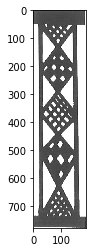

Labels correctos:
panel vertical cross-hatched lozenge checked chain 
Labels predichos:
panel vertical pattern metopal hatched triangle solid multiple dotted cross-hatched dot outline lozenge chain accompanied antithetic ray column 


219 78i


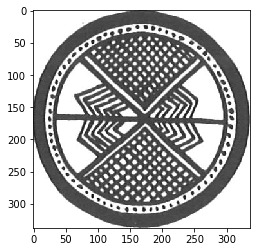

Labels correctos:
enclosing ornament chevron triangle stacked cross-hatched dot circle floor 
Labels predichos:
enclosing line ornament cross chevron hatched double triple multiple dotted cross-hatched cruciform star hatching dot quatrefoil circle outline reserved background octofoil chain leaf zigzag rosette flower floor point eleven-pointed forming midrib v-shaped twelve-leaved 


220 44p


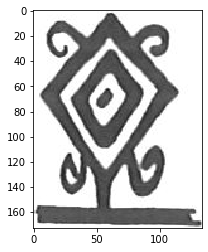

Labels correctos:
filling ornament star lozenge schematized 
Labels predichos:
enclosing filling ornament cross metopal hatched double hook dotted cross-hatched star dot circle outline quartered lozenge rectilinear outlined schematized lozenge-cross rosette wing 


221 53g


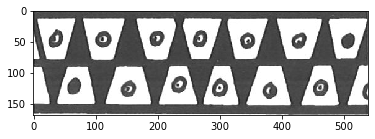

Labels correctos:
horizontal panel alternating dot accompanied antithetic ray 
Labels predichos:
horizontal panel alternating metopal hatched triangle solid double multiple hook pair cross-hatched checkerboard dot outline lozenge chain leaf accompanied antithetic ray ax windmill column 


222 78k


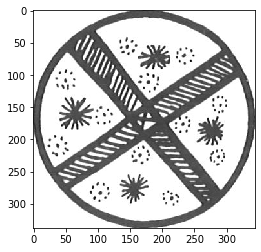

Labels correctos:
enclosing ornament cross hatched circle floor 
Labels predichos:
enclosing filling ornament cross hatched cross-hatched star dot quatrefoil circle outline hexafoil octofoil swastika outlined leaf rosette floor wing midrib 


223 47k


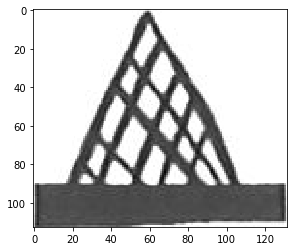

Labels correctos:
filling ornament triangle cross-hatched upright 
Labels predichos:
horizontal panel enclosing ornament hatched triangle cross-hatching double triple cross-hatched checkerboard shoulder dot outline lozenge form filled intertwinded 


224 62b


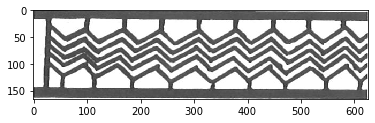

Labels correctos:
horizontal panel vertical bar apex multiple parallel zigzag 
Labels predichos:
horizontal panel bar hatched triangle apex field solid double triple parallel dotted cross-hatched checkerboard checkerboarded dot outline lozenge chain two-tiered net spaced leaf side form zigzag scribble 


225 75j


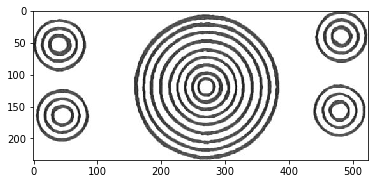

Labels correctos:
horizontal panel concentric circle 
Labels predichos:
horizontal panel enclosing hatched solid multiple concentric dot quatrefoil circle outline arrangement tangential rosette cable 


226 91d


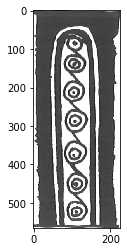

Labels correctos:
panel vertical filling tongue 
Labels predichos:
panel vertical bar filling triangle small solid double multiple single square dotted cross-hatched eight-pointed dot outline lozenge chain blob accompanied antithetic ray column tangets 


227 77f


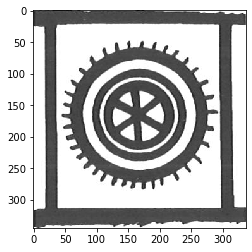

Labels correctos:
enclosing line metopal triple star circle fringe 
Labels predichos:
enclosing cross metopal hatched small multiple concentric dotted cross-hatched star hour-glass dot central circle outline lozenge arrangement tangential rosette point maltese seven-leaved sunburst 


228 8e


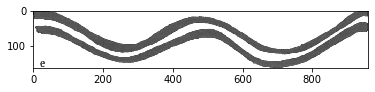

Labels correctos:
horizontal panel wavy band double 
Labels predichos:
horizontal panel enclosing line filling ornament cross metopal diagonal hatched triangle double concentric cross-hatched circle lozenge swastika 


229 77c


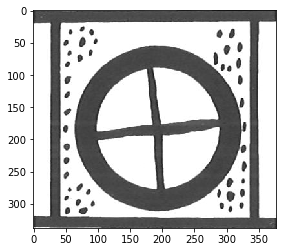

Labels correctos:
enclosing simple cross george's circle 
Labels predichos:
enclosing filling cross metopal diagonal hatched double dotted quarter cross-hatched checkerboard star hour-glass central circle outline lozenge swastika tangential four-spoked wheel sunburst 


230 16m


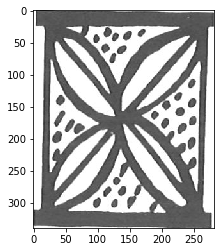

Labels correctos:
metopal dotted quatrefoil reserved background 
Labels predichos:
andrew's cross chevron metopal hatched stacked double dotted cross-hatched latticed spandrel doubled quatrefoil circle outline reserved background hexafoil confronted 


231 70n


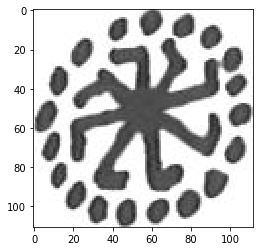

Labels correctos:
enclosing filling ornament dotted circle swastika eight-armed 
Labels predichos:
enclosing filling ornament cross composition pattern metopal hatched solid hook dotted quarter metope star circle rectilinear detached swastika outlined leaf windmill rosette floor body bird 


232 69e


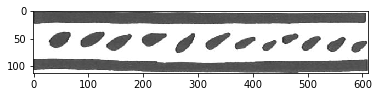

Labels correctos:
horizontal panel floating oblique row blob 
Labels predichos:
horizontal panel line filling ornament chevron small wavy band double multiple single dot circle swastika row tangential blob zigzag flanking 


233 7a


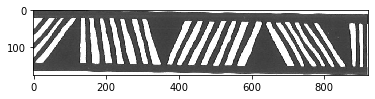

Labels correctos:
horizontal panel opposed diagonal triangle separated solid 
Labels predichos:
horizontal panel vertical bar enclosing shorter line filling ornament right opposed diagonal triangle separated solid single cross-hatched wolftooth star careless zigzag ax 




In [85]:
# load labels 
NUM_LABELS = 286
labels_val = pd.read_json(os.path.join(labels_path, 'val_df.json'), orient='index')
labels_test = pd.read_json(os.path.join(labels_path, 'test_df.json'), orient='index')

# get N top labels
train_labels = pd.read_json(os.path.join(labels_path, 'augmented_train_df.json'), orient='index')
if not os.path.isfile(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle')):
    print(f"Creando top_labels para {NUM_LABELS} labels")
    top_labels, _ = filter_labels(train_labels, number_labels = NUM_LABELS)
    save = input(f"Se creará un archivo nuevo para {len(top_labels)} labels. Desea continuar? (y/n)")
    if save == "y":
        with open(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'), 'wb') as f:
            pickle.dump(top_labels, f)
        print(top_labels)
    else:
        raise Exception("No se logró cargar top_labels")
else:
    print(f"Usando top_labels previamente generados para {NUM_LABELS} labels")
    with open(os.path.join(root_dir, 'labels', f'top_{NUM_LABELS}L.pickle'), 'rb') as f:
        top_labels = pickle.load(f)
    print(top_labels)
    
labels_frame = filter_dfs(labels_test, top_labels)

# load images
for i, idx in enumerate(labels_frame.index.values, 0):
    print(i, idx)
    img_id = labels_frame.loc[idx].name + '.png'
    img_name = None
    for chapter in os.listdir(os.path.join(patterns_path, 'test')):
      if img_id in os.listdir(os.path.join(patterns_path, 'test', chapter)):
        img_name = os.path.join(patterns_path, 'test', chapter, img_id)
        break
    # caso test-val
    if img_name is None:
      for chapter in os.listdir(os.path.join(patterns_path, 'val')):
        if img_id in os.listdir(os.path.join(patterns_path, 'val', chapter)):
          img_name = os.path.join(patterns_path, 'val', chapter, img_id)
          break
    if img_name is None:
      raise Exception(f'No se encontró la imagen para {img_id}')
    image = Image.open(img_name)
    image = image.convert('RGB')
    image = np.array(image)
    labels = labels_frame.loc[idx].values
    labels = np.array(labels)
    preds = predictions[i]
    
    img = image.reshape(-1, image.shape[1], 3) # imagen j 
    plt.imshow(img, interpolation='nearest')
    plt.show()
    labels_correctos = ""
    labels_predichos = ""
    for k in range(0, len(preds)):
      labels_correctos += (labels_frame.columns.values[k]+' ') if labels[k] else ""
      labels_predichos += (labels_frame.columns.values[k]+' ') if preds[k] else ""
    print("Labels correctos:")
    print(labels_correctos)
    print("Labels predichos:")
    print(labels_predichos)
    print("\n")
